In [ ]:
# original code https://www.kaggle.com/code/utkarshsaxenadn/water-body-segmentation-unet-model

# common
import os 
import keras
from tqdm import tqdm
from glob import glob
import tensorflow as tf
from numpy import zeros
from numpy.random import randint


# Data
from tensorflow.image import resize
from keras.preprocessing.image import load_img, img_to_array

# Data Viz
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input, multiply, concatenate, add, Layer, Dropout
from tensorflow.keras.models import Model
# from tensorflow.keras.applications import ResNet50

# Model Functions

from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import Callback, ModelCheckpoint

In [ ]:
def load_image(path):
    img = resize(img_to_array(load_img(path))/255., (256,256))
    return img

In [ ]:
import os

# Define the root directory of your dataset
dataset_root = "./MainDir/Untitled Folder/water_v1/water_v1"

# Create lists to store image and annotation file paths
image_paths = []
annotation_paths = []

# Define the subfolders for images and annotations
image_subfolder = "JPEGImages"
annotation_subfolder = "Annotations"

# Traverse the dataset directory and its subfolders
for root, dirs, files in os.walk(dataset_root):
    # Check if the current directory is an image subfolder
    if image_subfolder in root:
        # Iterate through image files
        for filename in files:
            if filename.endswith(".png"):
                image_path = os.path.join(root, filename)
                # Create the corresponding annotation path
                annotation_path = image_path.replace(image_subfolder, annotation_subfolder)
                annotation_path = annotation_path.replace(".png", ".png")

                # Append the paths to the lists
                image_paths.append(image_path)
                annotation_paths.append(annotation_path)

# Verify if the lengths of image_paths and annotation_paths are the same
if len(image_paths) != len(annotation_paths):
    print("Warning: Mismatch between the number of images and annotations.")

# Now, you have two lists containing image and annotation file paths
# image_paths contains the paths to the image files
# annotation_paths contains the paths to the annotation (mask) files

# image_path = "./MainDir/Untitled Folder/water_v1/water_v1/JPEGImages/ADE20K"
total_images = len((image_paths))
print(f"Total Number of Images : {total_images}")

In [ ]:
all_image_paths = image_paths

In [ ]:
def load_data(paths):
    images = zeros(shape=(len(paths), 256,256,3))
    masks = zeros(shape=(len(paths), 256,256,3))
    for i, path in tqdm(enumerate(paths), desc="Loading"):
        image = load_image(path)
        images[i] = image
        
        mask_path = path.replace("JPEGImages", "Annotations")
        mask = load_image(mask_path)
        masks[i] = mask
    return images, masks

In [ ]:
train_paths = all_image_paths[:1800]
X_train, y_train = load_data(train_paths)

In [ ]:
val_paths = all_image_paths[1800:]
X_val, y_val = load_data(val_paths)

In [ ]:
def show_image(image, title=None):
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')

In [ ]:
for i in range(10):
    id = randint(1000)
    image, mask = X_train[id], y_train[id]
    plt.figure(figsize=(10,8))
    
    plt.subplot(1,2,1)
    show_image(image, title="Image")
    
    plt.subplot(1,2,2)
    show_image(mask, title="Mask")
    
    plt.tight_layout()
    plt.show()

In [ ]:
class Encoder(Layer):
    
    def __init__(self, filters, rate, pooling=True, **kwargs):
        super(Encoder, self).__init__(**kwargs)
        
        self.filters = filters
        self.rate = rate
        self.pooling = pooling
        
        self.bn = BatchNormalization()
        self.c1 = Conv2D(filters, kernel_size=3, padding='same', activation='relu', kernel_initializer="he_normal")
        self.drop = Dropout(rate)
        self.c2 = Conv2D(filters, kernel_size=3, padding='same', activation='relu', kernel_initializer="he_normal")
        self.drop2 = Dropout(rate)
        self.c3 = Conv2D(filters, kernel_size=3, padding='same', activation='relu', kernel_initializer="he_normal")
        self.pool = MaxPool2D()
        
        
    def call(self, X):
        x = self.bn(X)
        x = self.c1(x)
        x = self.drop(x)
        x = self.c2(x)
        x = self.drop2(x)
        x = self.c3(x)

        if self.pooling:
            y = self.pool(x)
            return y, x
        else:
            return x
        

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            "rate":self.rate,
            "pooling":self.pooling
        }


In [ ]:
class Decoder(Layer):
    
    def __init__(self, filters, rate, **kwargs):
        super(Decoder, self).__init__(**kwargs)
        
        self.filters = filters
        self.rate = rate
        
        self.bn = BatchNormalization()
        self.cT = Conv2DTranspose(filters, kernel_size=3, strides=2, padding='same', activation='relu', kernel_initializer="he_normal")
        self.net = Encoder(filters, rate, pooling=False)
        
    def call(self, X):
        x, skip_x = X
        x = self.bn(x)
        x = self.cT(x)
        x = concatenate([x, skip_x])
        x = self.net(x)
        return x
            
    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            "rate":self.rate,
        }

In [ ]:
from keras.losses import binary_crossentropy
import keras.backend as K

# Define the Dice loss function
def DiceLoss(targets, inputs, smooth=1e-6):    
    inputs = K.flatten(inputs)
    targets = K.flatten(targets)
    
    intersection = K.sum(targets * inputs)
    dice_loss = 1 - (2 * intersection + smooth) / (K.sum(targets) + K.sum(inputs) + smooth)
    
    return dice_loss

# Combine Dice loss with Binary Cross-Entropy
def DiceBCELoss(targets, inputs, smooth=1e-6):    
    bce_loss = binary_crossentropy(targets, inputs)
    dice_loss = DiceLoss(targets, inputs, smooth)
    dice_bce_loss = bce_loss + dice_loss
    
    return dice_bce_loss

In [ ]:
# Inputs
unet_inputs = Input(shape=(256,256,3), name="UNetInput")

# Encoder Network : Downsampling phase
p1, c1 = Encoder(64, 0.1, name="Encoder1")(unet_inputs)
p2, c2 = Encoder(128, 0.1, name="Encoder2")(p1)
p3, c3 = Encoder(256, 0.2, name="Encoder3")(p2)
p4, c4 = Encoder(512, 0.2, name="Encoder4")(p3)


# Encoding Layer : Latent Representation
e = Encoder(512, 0.3, pooling=False)(p4)

# Attention + Decoder Network : Upsampling phase.
d1 = Decoder(512, 0.2, name="Decoder1")([e, c4])
d2 = Decoder(256, 0.2, name="Decoder2")([d1, c3])
d3 = Decoder(128, 0.1, name="Decoder3")([d2, c2])
d4 = Decoder(64, 0.1, name="Decoder4")([d3, c1])

# Output
unet_out = Conv2D(3, kernel_size=3, padding='same', activation='sigmoid')(d4)

# Model
UNet = Model(
    inputs=unet_inputs,
    outputs=unet_out,
    name="AttentionUNet"
)

# Compiling
UNet.compile(
     loss='binary_crossentropy',
    #loss=DiceBCELoss,
    optimizer='adam'
)

In [ ]:
plot_model(UNet, "UNet-WaterBody.png", show_shapes=True)

In [ ]:
BATCH_SIZE = 16
SPE = len(X_train)//BATCH_SIZE

In [ ]:
class ShowProgress(Callback):
    def on_epoch_end(self, epoch, logs=None):
        id = randint(len(X_val))
        image = X_val[id]
        mask = y_val[id]
        pred_mask = self.model(tf.expand_dims(image,axis=0))[0]
        
        plt.figure(figsize=(10,8))
        plt.subplot(1,3,1)
        show_image(image, title="Original Image")
        
        plt.subplot(1,3,2)
        show_image(mask, title="Original Mask")
        
        plt.subplot(1,3,3)
        show_image(pred_mask, title="Predicted Mask")
            
        plt.tight_layout()
        plt.show()

In [ ]:
cbs = [
    ModelCheckpoint("UNet-WaterBodySegmentation.h5", save_best_only=True),
    ShowProgress()
]

112/112 [==============================] - ETA: 0s - loss: 0.1890

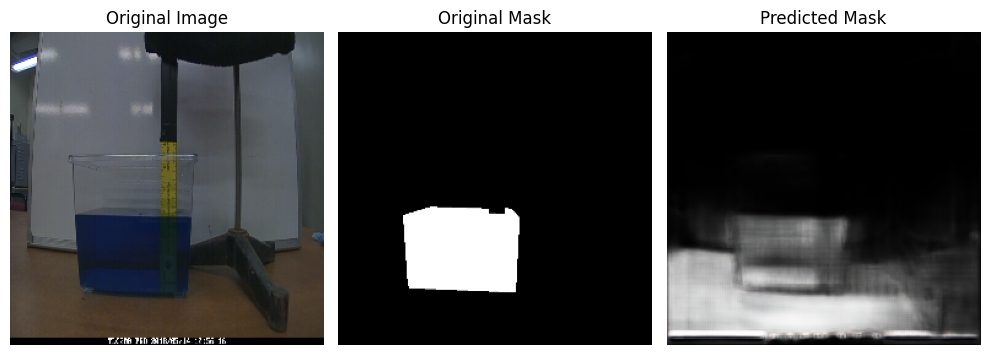

112/112 [==============================] - 48s 431ms/step - loss: 0.1890 - val_loss: 0.3394
Epoch 47/200
112/112 [==============================] - ETA: 0s - loss: 0.1981

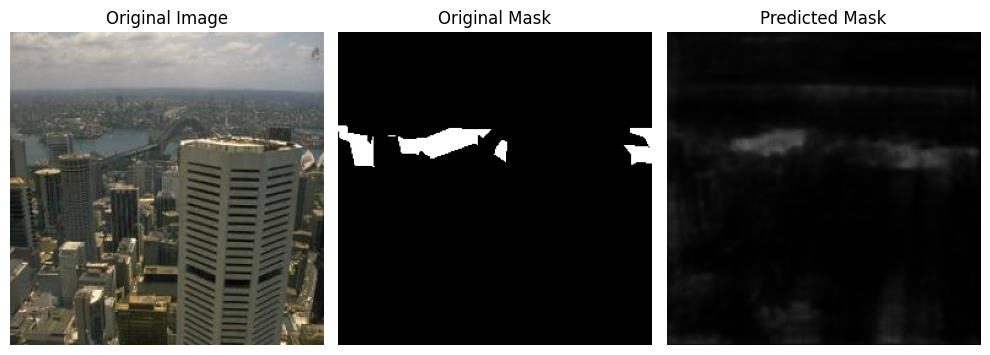

112/112 [==============================] - 48s 430ms/step - loss: 0.1981 - val_loss: 0.3299
Epoch 48/200
112/112 [==============================] - ETA: 0s - loss: 0.1854

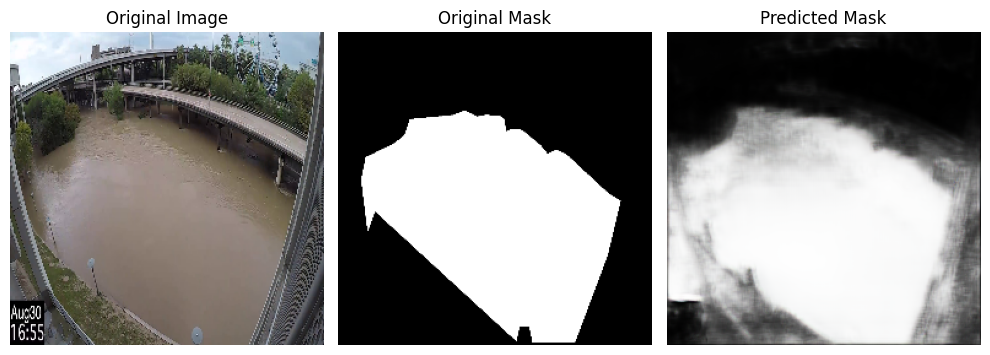

112/112 [==============================] - 48s 433ms/step - loss: 0.1854 - val_loss: 0.4256
Epoch 49/200
112/112 [==============================] - ETA: 0s - loss: 0.1910

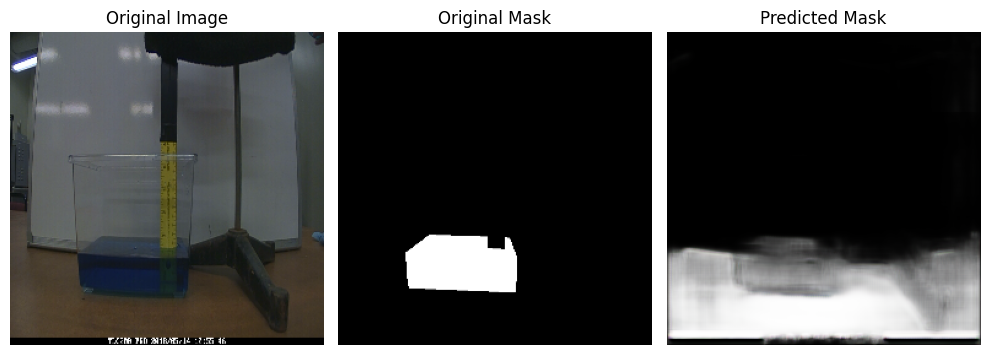

112/112 [==============================] - 48s 430ms/step - loss: 0.1910 - val_loss: 0.4089
Epoch 50/200
112/112 [==============================] - ETA: 0s - loss: 0.1889

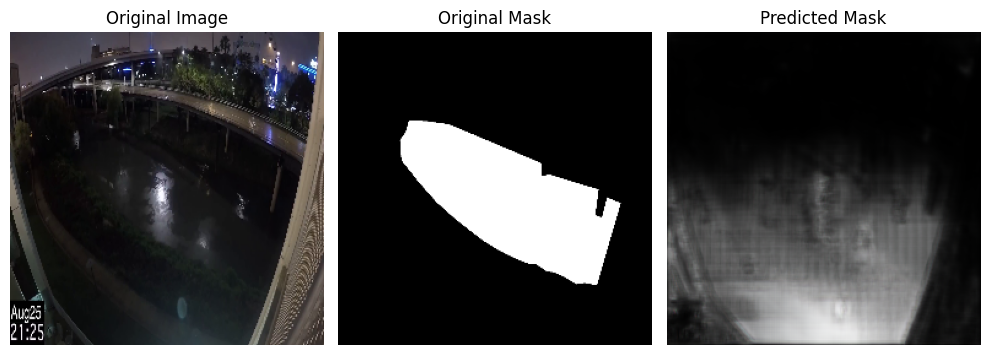

112/112 [==============================] - 48s 429ms/step - loss: 0.1889 - val_loss: 0.3827
Epoch 51/200
112/112 [==============================] - ETA: 0s - loss: 0.1812

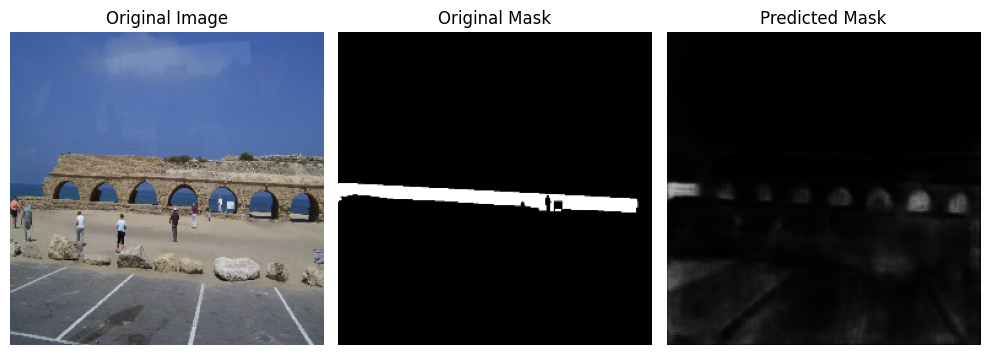

112/112 [==============================] - 48s 430ms/step - loss: 0.1812 - val_loss: 0.3551
Epoch 52/200
112/112 [==============================] - ETA: 0s - loss: 0.1762

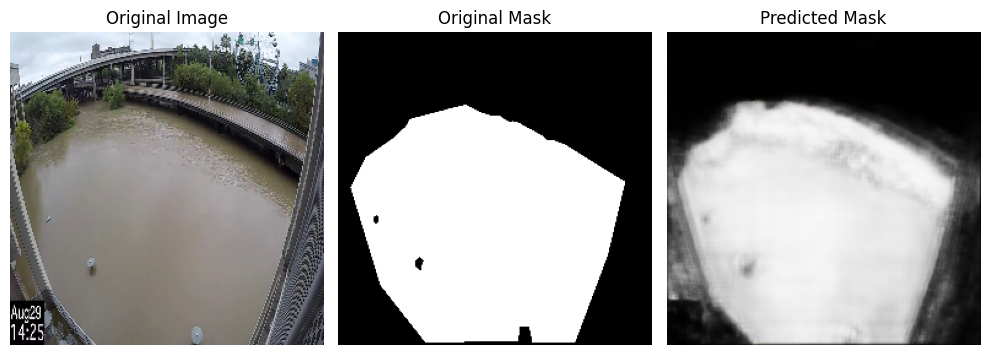

112/112 [==============================] - 48s 431ms/step - loss: 0.1762 - val_loss: 0.3337
Epoch 53/200
112/112 [==============================] - ETA: 0s - loss: 0.1735

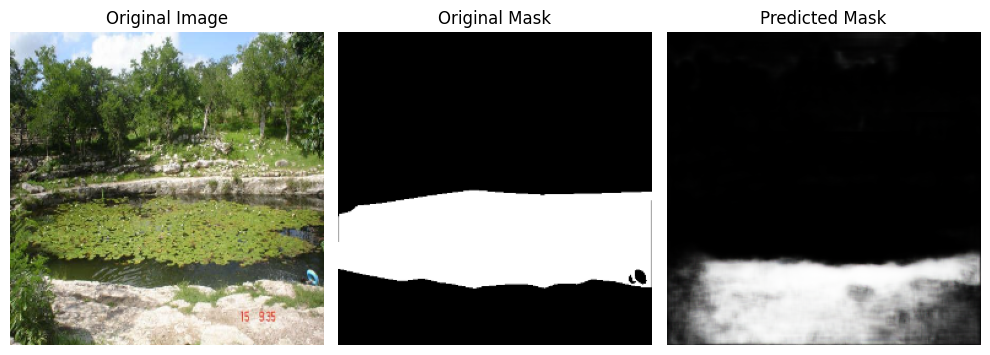

112/112 [==============================] - 48s 430ms/step - loss: 0.1735 - val_loss: 0.3498
Epoch 54/200
112/112 [==============================] - ETA: 0s - loss: 0.1803

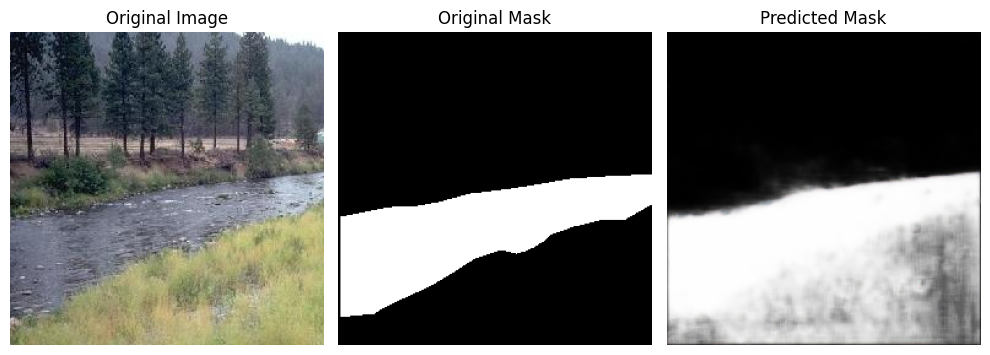

112/112 [==============================] - 48s 430ms/step - loss: 0.1803 - val_loss: 0.3727
Epoch 55/200
112/112 [==============================] - ETA: 0s - loss: 0.1774

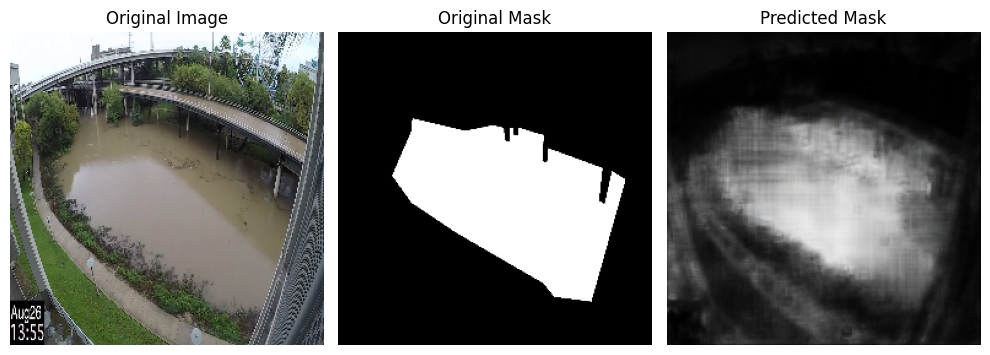

112/112 [==============================] - 48s 430ms/step - loss: 0.1774 - val_loss: 0.3431
Epoch 56/200
112/112 [==============================] - ETA: 0s - loss: 0.1687

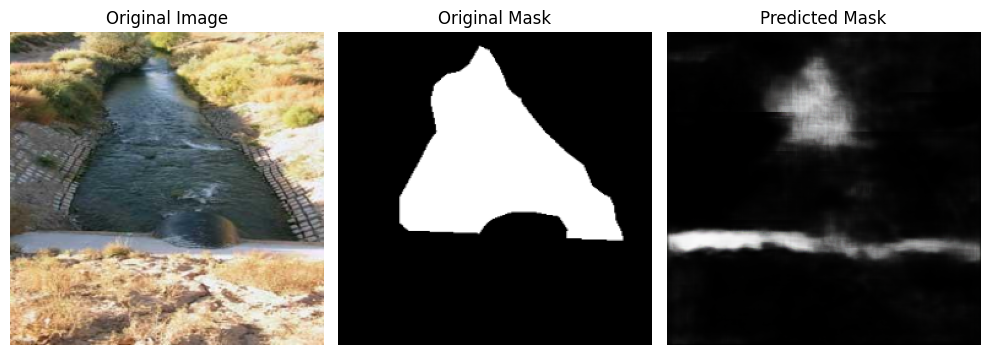

112/112 [==============================] - 48s 431ms/step - loss: 0.1687 - val_loss: 0.4141
Epoch 57/200
112/112 [==============================] - ETA: 0s - loss: 0.1717

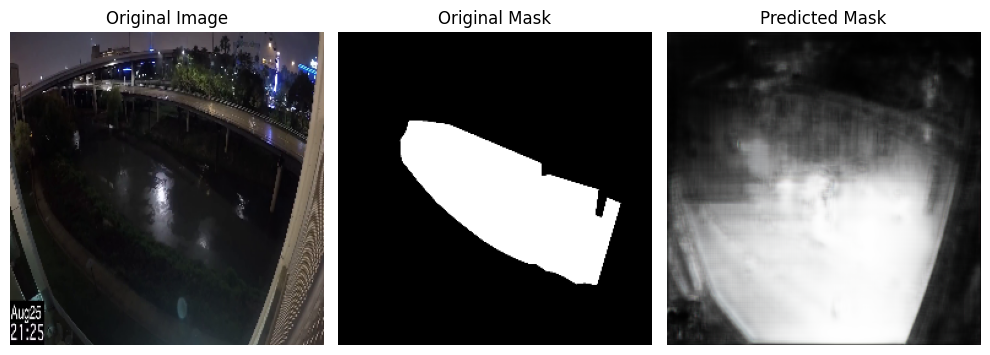

112/112 [==============================] - 48s 430ms/step - loss: 0.1717 - val_loss: 0.4021
Epoch 58/200
112/112 [==============================] - ETA: 0s - loss: 0.1709

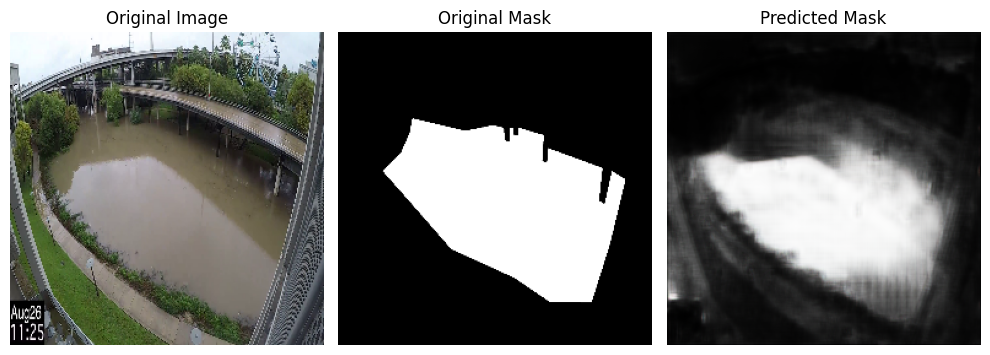

112/112 [==============================] - 48s 430ms/step - loss: 0.1709 - val_loss: 0.3693
Epoch 59/200
112/112 [==============================] - ETA: 0s - loss: 0.1602

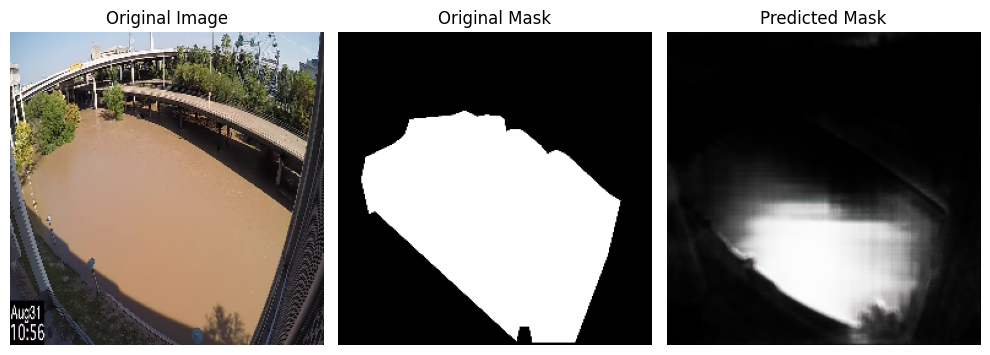

112/112 [==============================] - 48s 430ms/step - loss: 0.1602 - val_loss: 0.3944
Epoch 60/200
112/112 [==============================] - ETA: 0s - loss: 0.1658

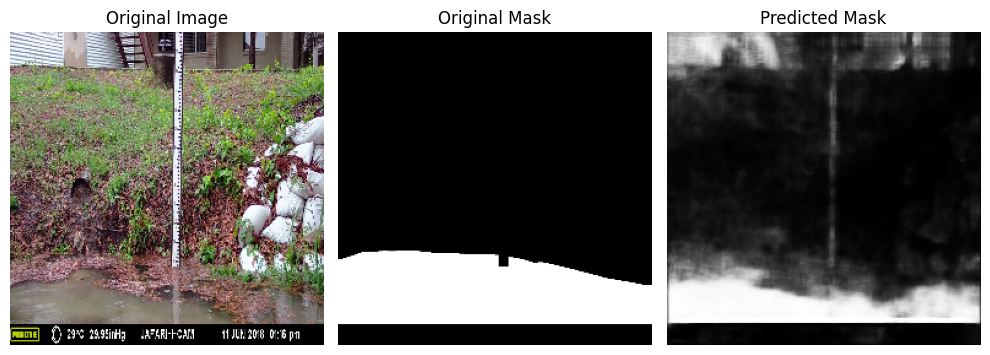

112/112 [==============================] - 48s 430ms/step - loss: 0.1658 - val_loss: 0.4536
Epoch 61/200
112/112 [==============================] - ETA: 0s - loss: 0.1554

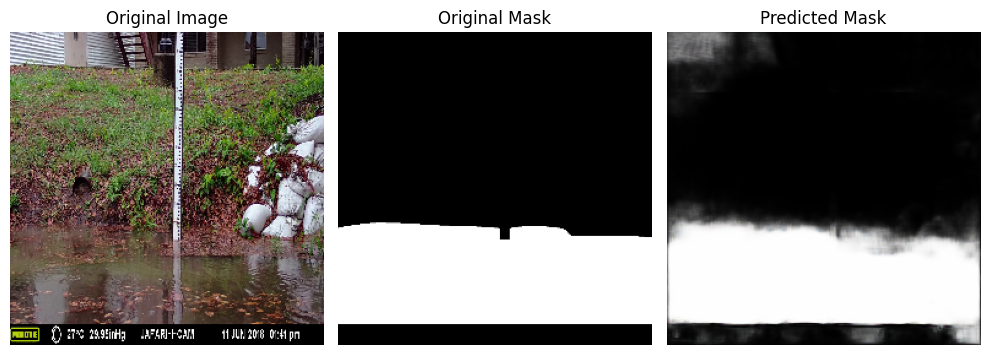

112/112 [==============================] - 48s 430ms/step - loss: 0.1554 - val_loss: 0.3390
Epoch 62/200
112/112 [==============================] - ETA: 0s - loss: 0.1568

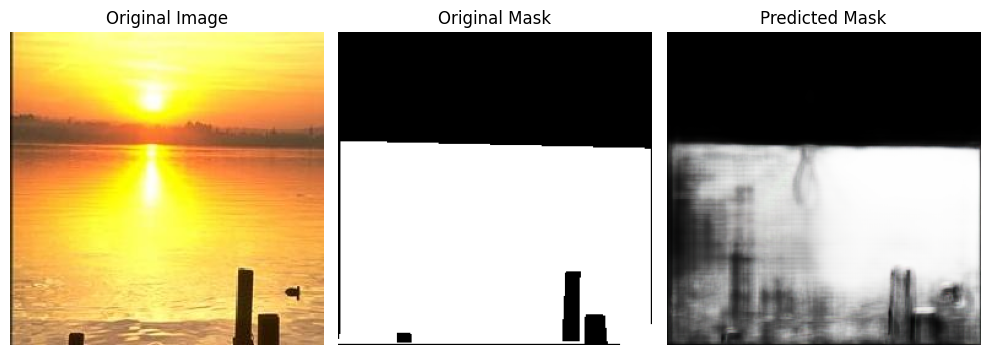

112/112 [==============================] - 48s 430ms/step - loss: 0.1568 - val_loss: 0.3830
Epoch 63/200
112/112 [==============================] - ETA: 0s - loss: 0.1555

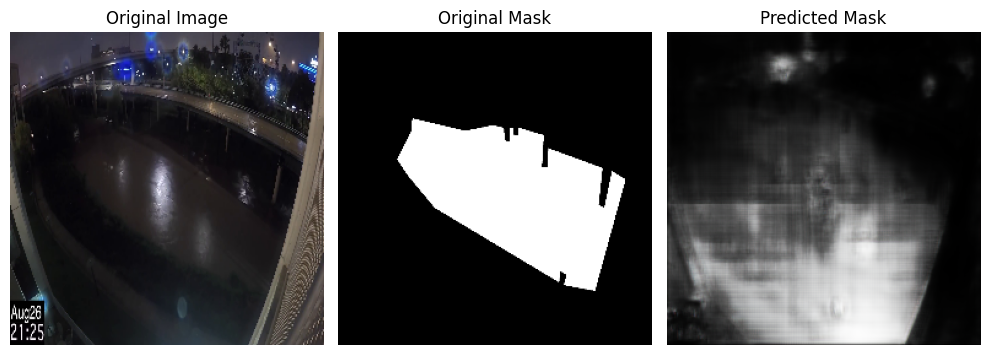

112/112 [==============================] - 48s 433ms/step - loss: 0.1555 - val_loss: 0.3935
Epoch 64/200
112/112 [==============================] - ETA: 0s - loss: 0.1500

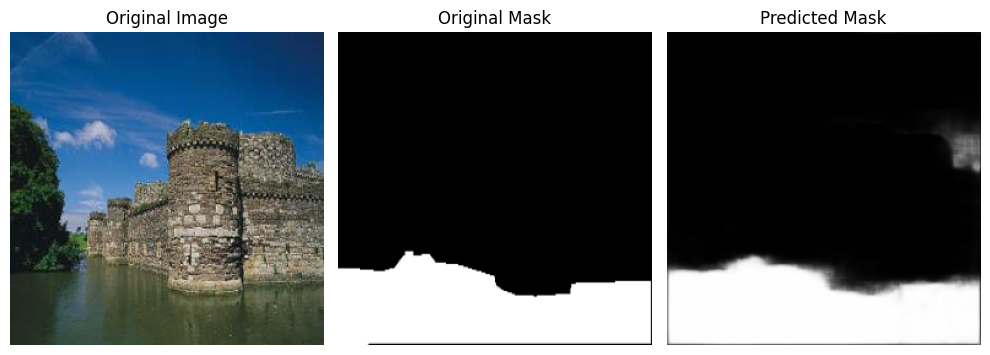

112/112 [==============================] - 48s 431ms/step - loss: 0.1500 - val_loss: 0.4144
Epoch 65/200
112/112 [==============================] - ETA: 0s - loss: 0.1469

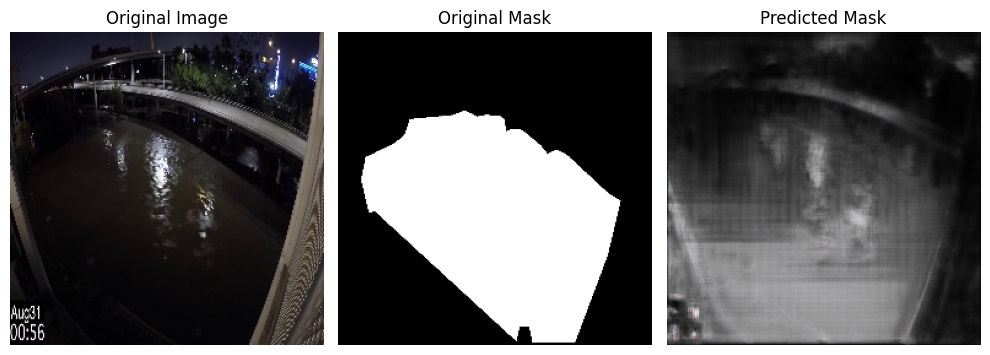

112/112 [==============================] - 48s 431ms/step - loss: 0.1469 - val_loss: 0.3659
Epoch 66/200
112/112 [==============================] - ETA: 0s - loss: 0.1343

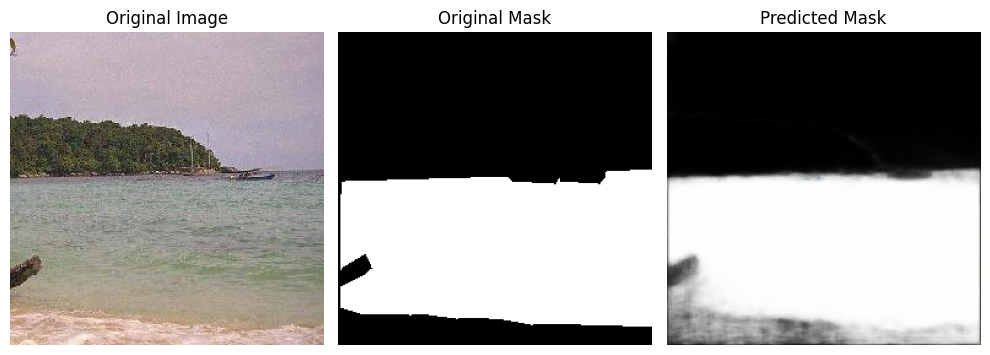

112/112 [==============================] - 48s 431ms/step - loss: 0.1343 - val_loss: 0.3385
Epoch 67/200
112/112 [==============================] - ETA: 0s - loss: 0.1347

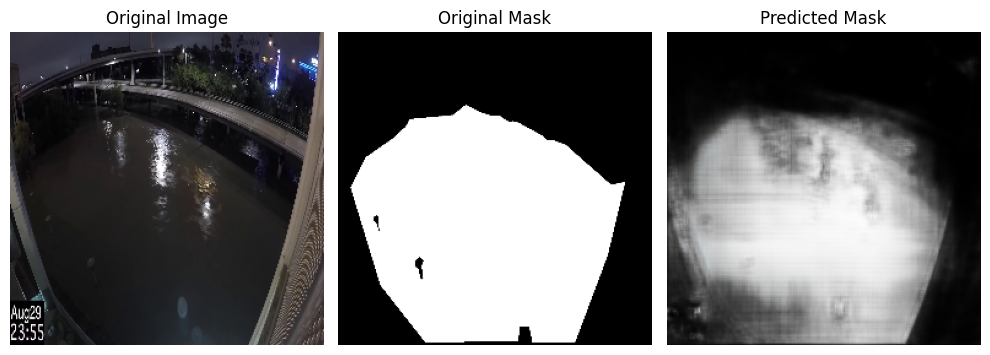

112/112 [==============================] - 48s 431ms/step - loss: 0.1347 - val_loss: 0.4362
Epoch 68/200
112/112 [==============================] - ETA: 0s - loss: 0.1415

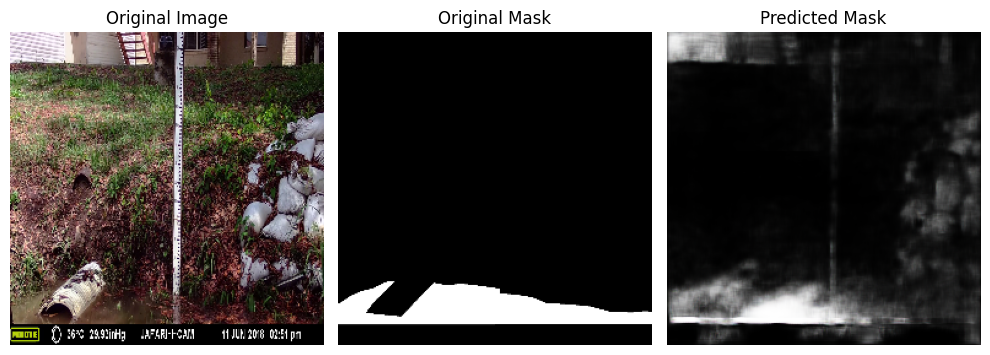

112/112 [==============================] - 49s 441ms/step - loss: 0.1415 - val_loss: 0.3073
Epoch 69/200
112/112 [==============================] - ETA: 0s - loss: 0.1359

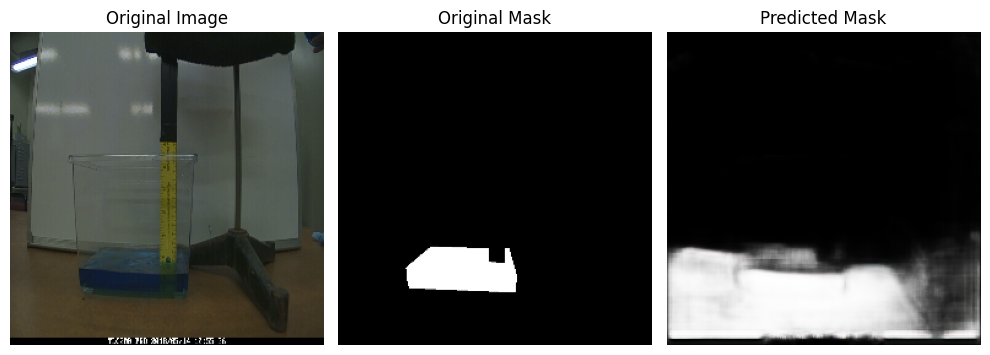

112/112 [==============================] - 48s 431ms/step - loss: 0.1359 - val_loss: 0.3971
Epoch 70/200
112/112 [==============================] - ETA: 0s - loss: 0.1442

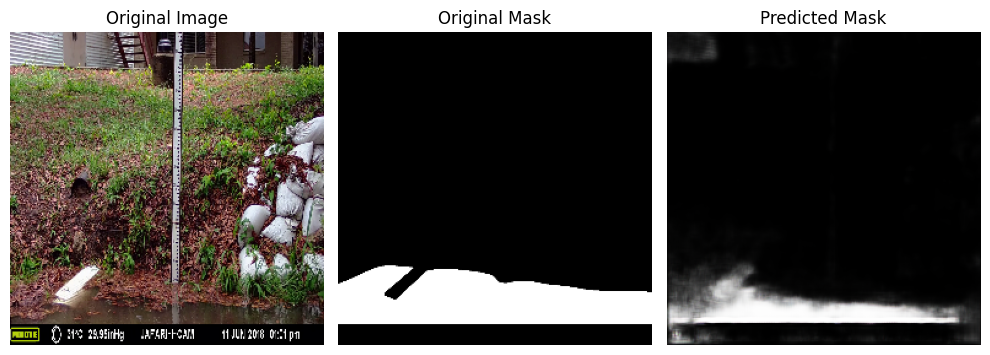

112/112 [==============================] - 48s 431ms/step - loss: 0.1442 - val_loss: 0.3476
Epoch 71/200
112/112 [==============================] - ETA: 0s - loss: 0.1344

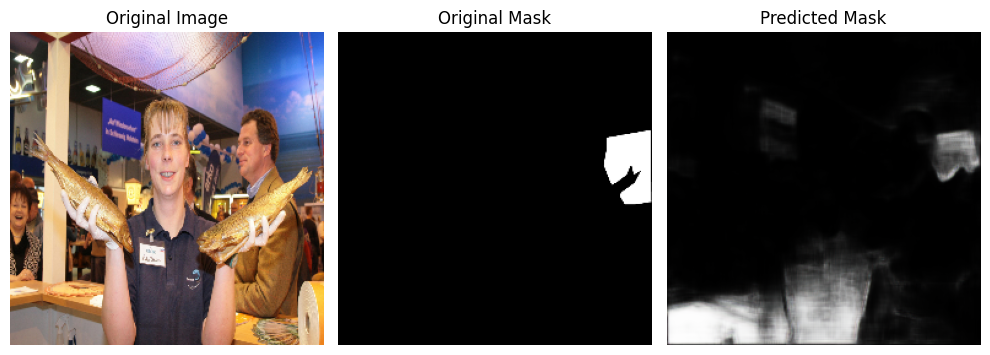

112/112 [==============================] - 48s 431ms/step - loss: 0.1344 - val_loss: 0.3300
Epoch 72/200
112/112 [==============================] - ETA: 0s - loss: 0.1303

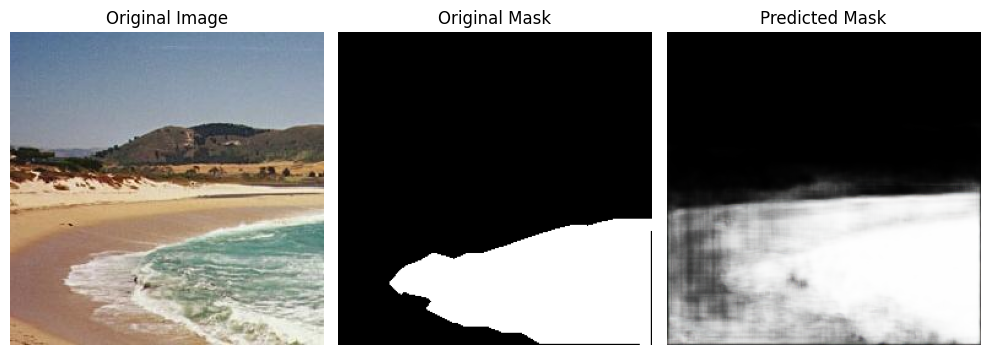

112/112 [==============================] - 48s 431ms/step - loss: 0.1303 - val_loss: 0.4222
Epoch 73/200
112/112 [==============================] - ETA: 0s - loss: 0.1281

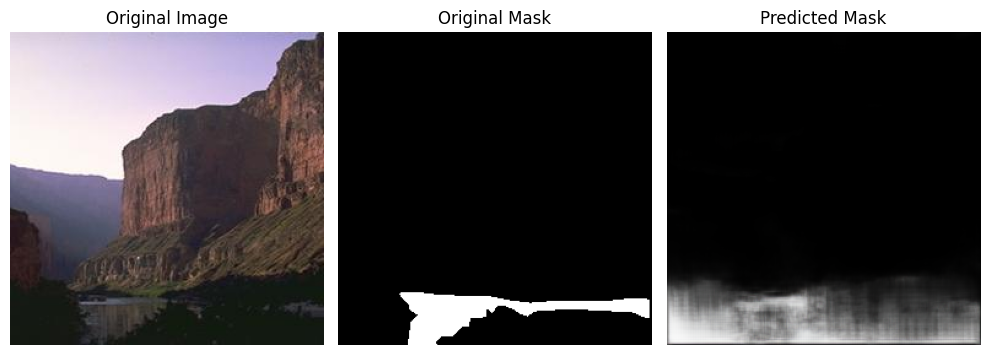

112/112 [==============================] - 48s 431ms/step - loss: 0.1281 - val_loss: 0.3972
Epoch 74/200
112/112 [==============================] - ETA: 0s - loss: 0.1229

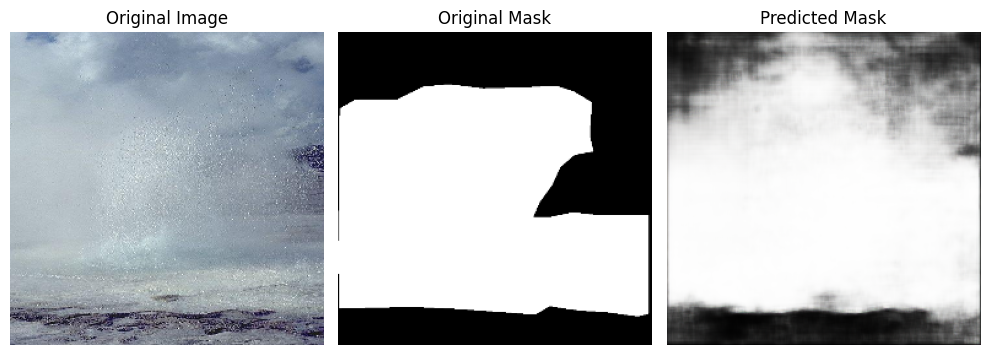

112/112 [==============================] - 48s 430ms/step - loss: 0.1229 - val_loss: 0.4037
Epoch 75/200
112/112 [==============================] - ETA: 0s - loss: 0.1280

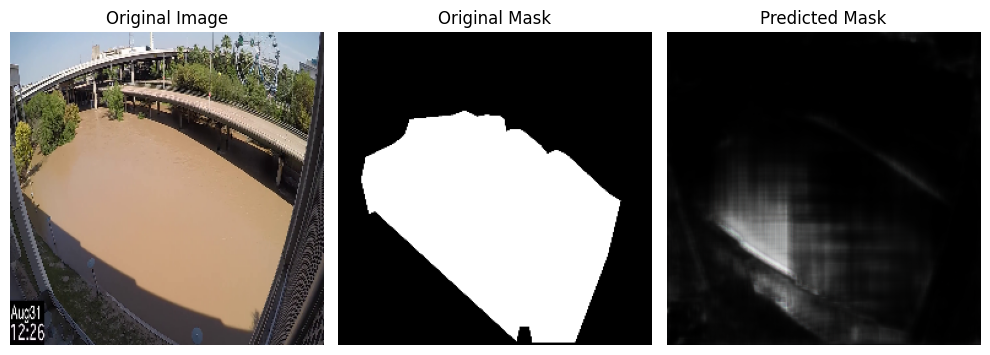

112/112 [==============================] - 48s 430ms/step - loss: 0.1280 - val_loss: 0.3705
Epoch 76/200
112/112 [==============================] - ETA: 0s - loss: 0.1234

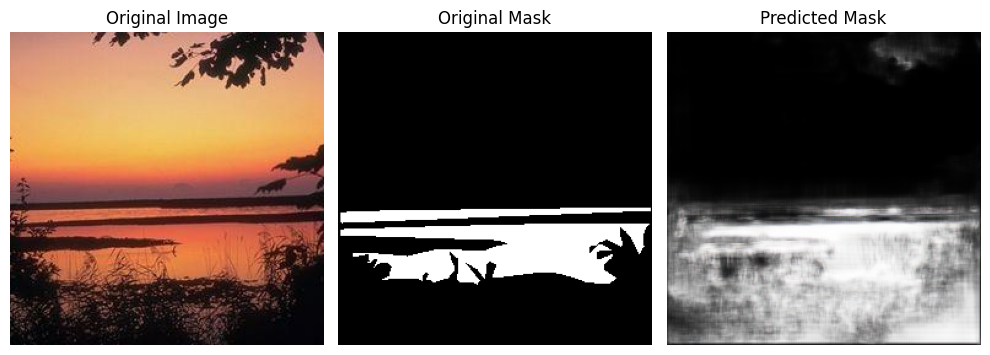

112/112 [==============================] - 48s 431ms/step - loss: 0.1234 - val_loss: 0.3732
Epoch 77/200
112/112 [==============================] - ETA: 0s - loss: 0.1171

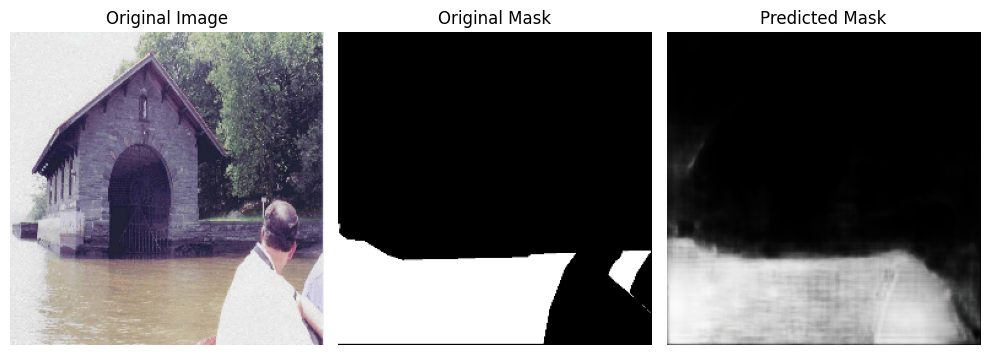

112/112 [==============================] - 48s 431ms/step - loss: 0.1171 - val_loss: 0.3985
Epoch 78/200
112/112 [==============================] - ETA: 0s - loss: 0.1205

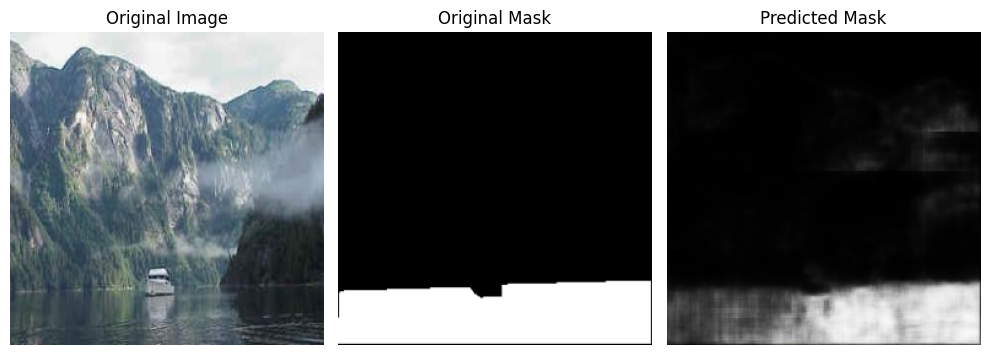

112/112 [==============================] - 48s 430ms/step - loss: 0.1205 - val_loss: 0.4022
Epoch 79/200
112/112 [==============================] - ETA: 0s - loss: 0.1188

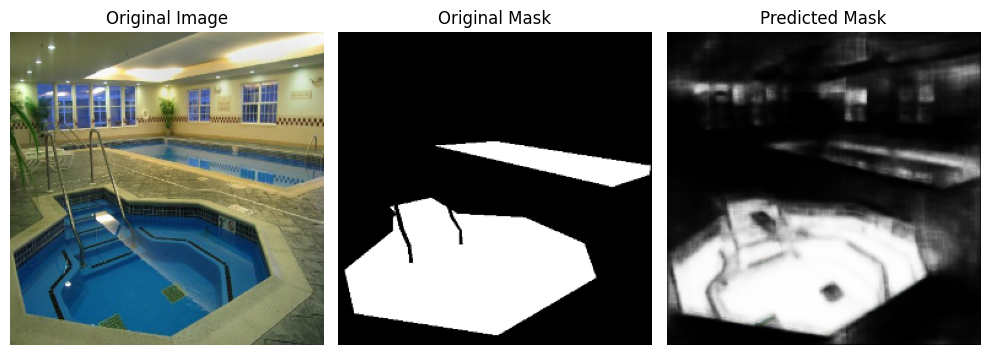

112/112 [==============================] - 48s 432ms/step - loss: 0.1188 - val_loss: 0.4430
Epoch 80/200
112/112 [==============================] - ETA: 0s - loss: 0.1218

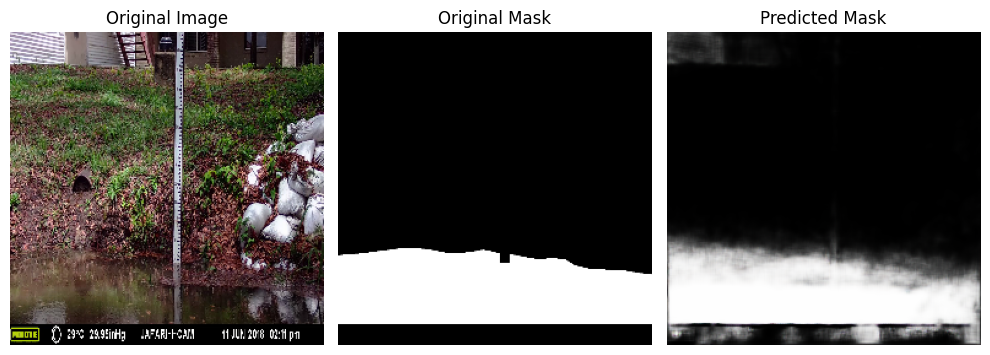

112/112 [==============================] - 48s 430ms/step - loss: 0.1218 - val_loss: 0.4837
Epoch 81/200
112/112 [==============================] - ETA: 0s - loss: 0.1238

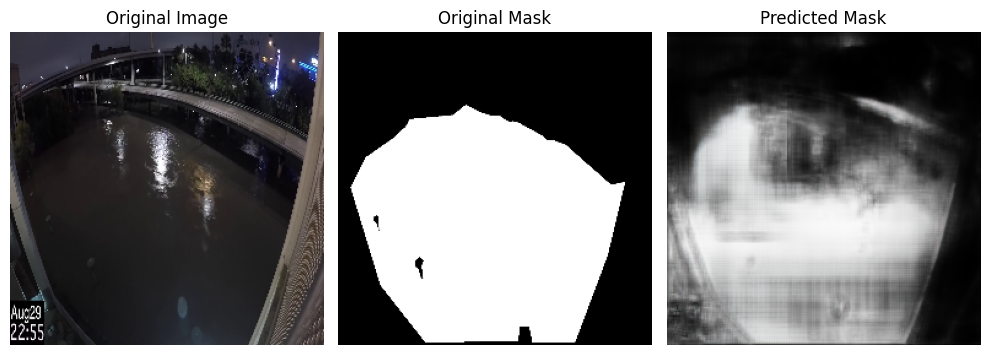

112/112 [==============================] - 48s 430ms/step - loss: 0.1238 - val_loss: 0.4167
Epoch 82/200
112/112 [==============================] - ETA: 0s - loss: 0.1227

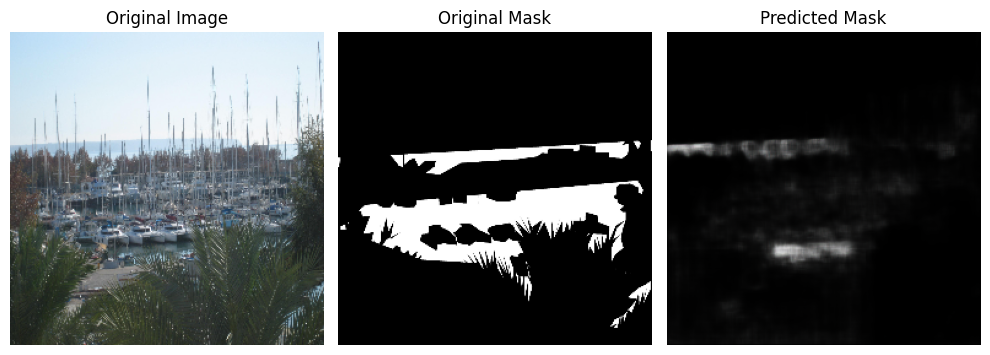

112/112 [==============================] - 48s 431ms/step - loss: 0.1227 - val_loss: 0.4636
Epoch 83/200
112/112 [==============================] - ETA: 0s - loss: 0.1110

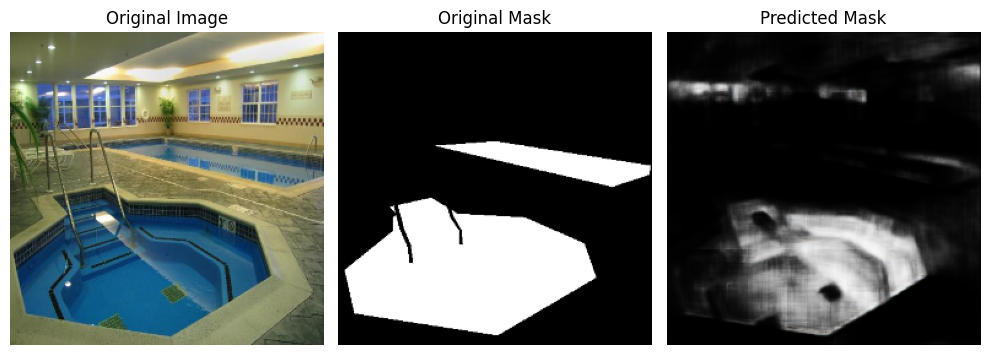

112/112 [==============================] - 48s 431ms/step - loss: 0.1110 - val_loss: 0.4387
Epoch 84/200
112/112 [==============================] - ETA: 0s - loss: 0.1083

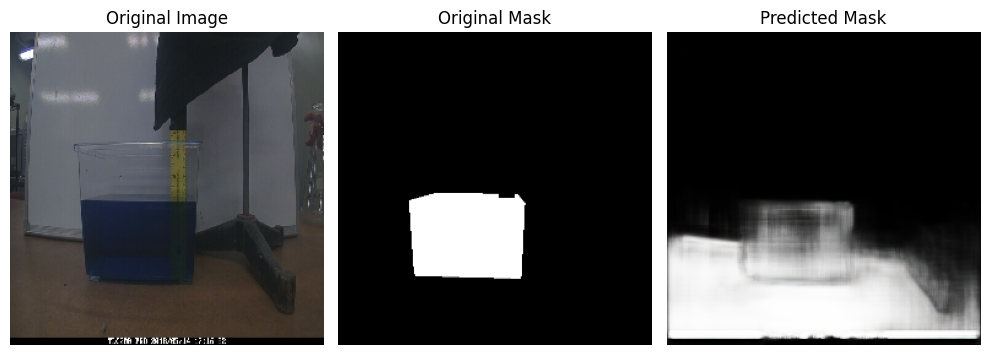

112/112 [==============================] - 48s 431ms/step - loss: 0.1083 - val_loss: 0.4801
Epoch 85/200
112/112 [==============================] - ETA: 0s - loss: 0.1066

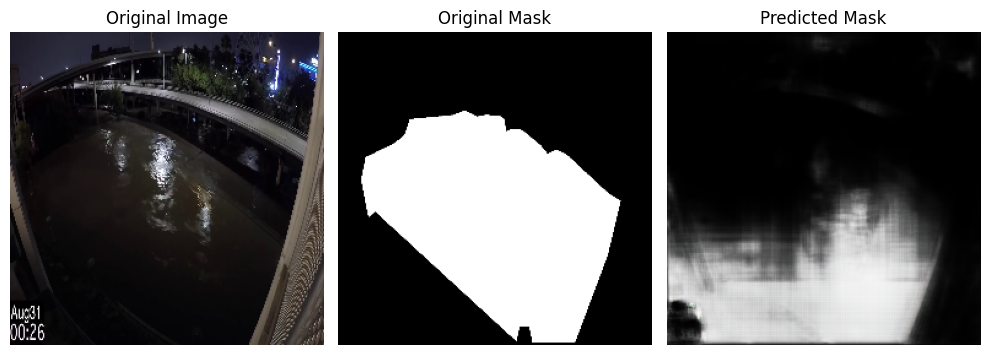

112/112 [==============================] - 48s 431ms/step - loss: 0.1066 - val_loss: 0.5676
Epoch 86/200
112/112 [==============================] - ETA: 0s - loss: 0.0998

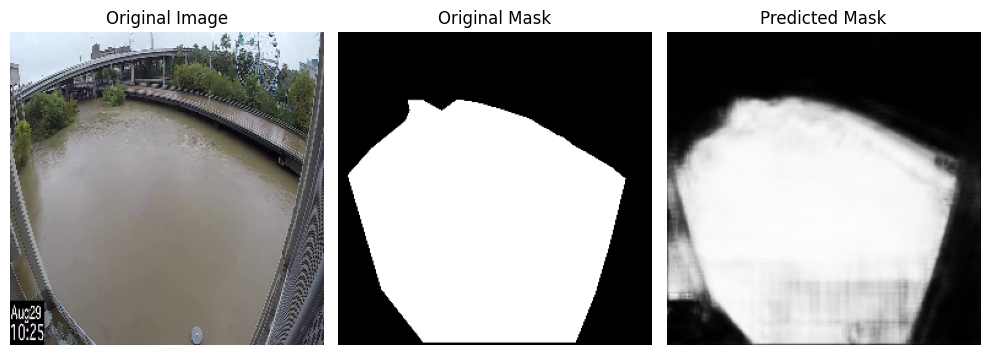

112/112 [==============================] - 48s 430ms/step - loss: 0.0998 - val_loss: 0.3979
Epoch 87/200
112/112 [==============================] - ETA: 0s - loss: 0.1078

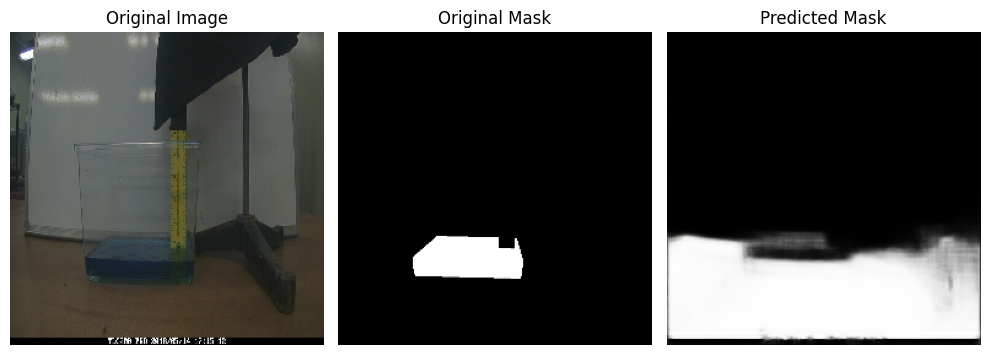

112/112 [==============================] - 48s 431ms/step - loss: 0.1078 - val_loss: 0.4681
Epoch 88/200
112/112 [==============================] - ETA: 0s - loss: 0.1061

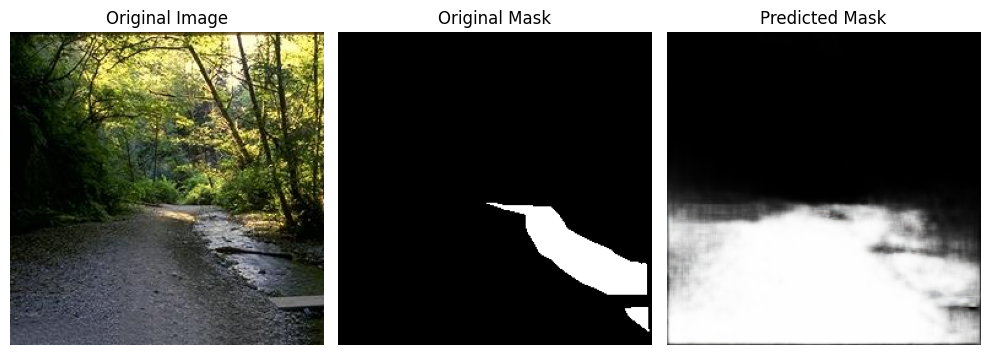

112/112 [==============================] - 48s 430ms/step - loss: 0.1061 - val_loss: 0.4568
Epoch 89/200
112/112 [==============================] - ETA: 0s - loss: 0.1015

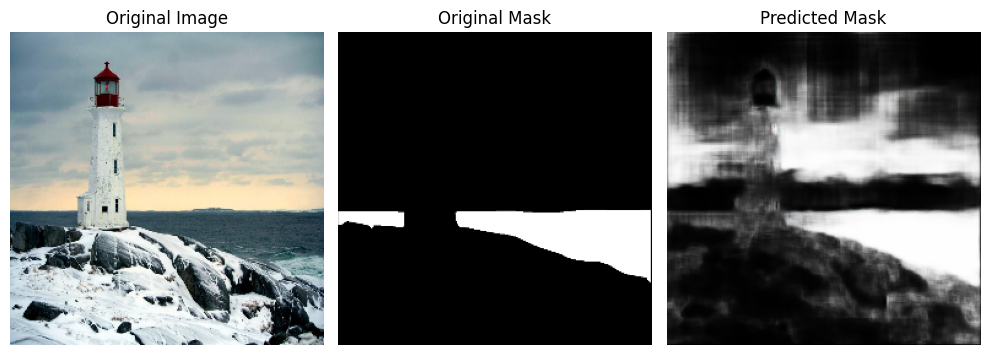

112/112 [==============================] - 48s 431ms/step - loss: 0.1015 - val_loss: 0.4836
Epoch 90/200
112/112 [==============================] - ETA: 0s - loss: 0.1026

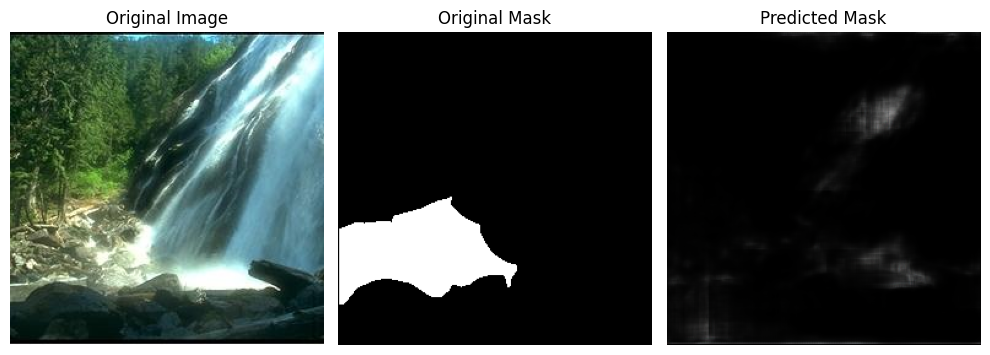

112/112 [==============================] - 48s 430ms/step - loss: 0.1026 - val_loss: 0.4339
Epoch 91/200
112/112 [==============================] - ETA: 0s - loss: 0.1034

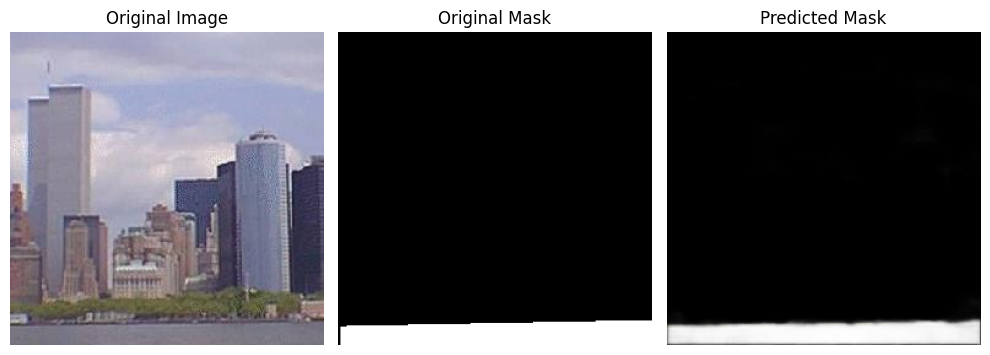

112/112 [==============================] - 48s 430ms/step - loss: 0.1034 - val_loss: 0.4376
Epoch 92/200
112/112 [==============================] - ETA: 0s - loss: 0.0958

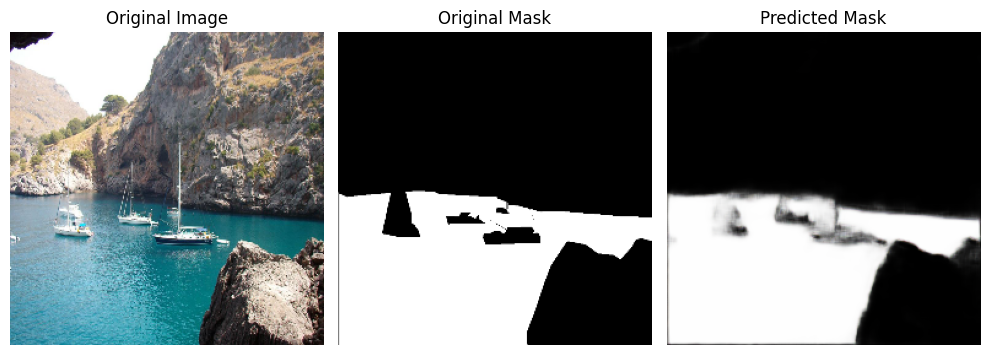

112/112 [==============================] - 48s 431ms/step - loss: 0.0958 - val_loss: 0.4841
Epoch 93/200
112/112 [==============================] - ETA: 0s - loss: 0.0966

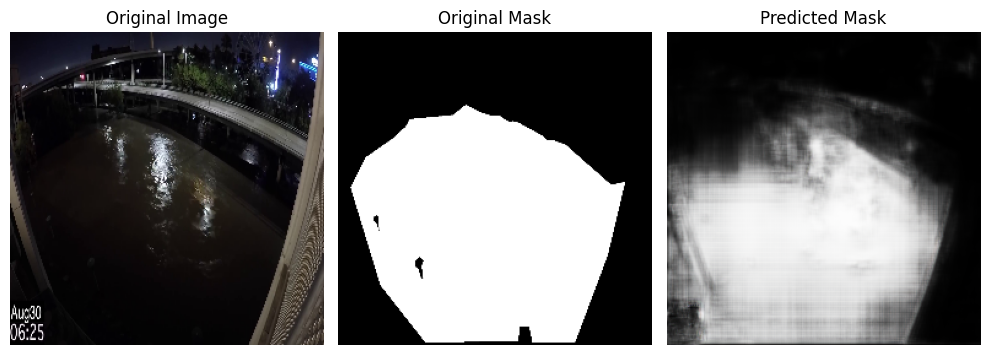

112/112 [==============================] - 48s 431ms/step - loss: 0.0966 - val_loss: 0.4651
Epoch 94/200
112/112 [==============================] - ETA: 0s - loss: 0.0944

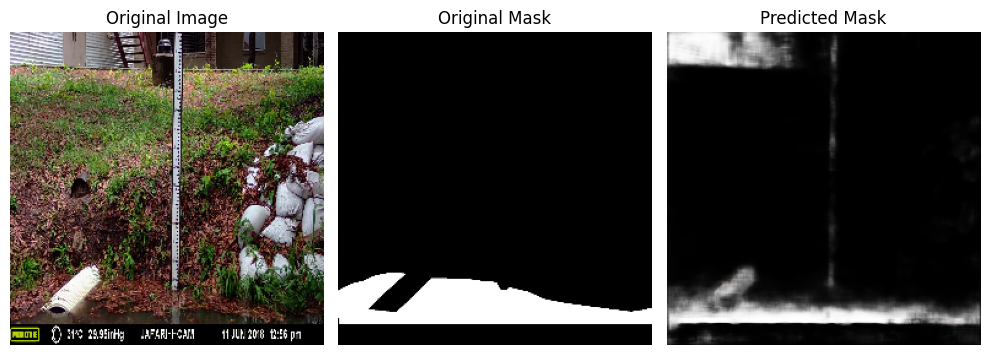

112/112 [==============================] - 48s 433ms/step - loss: 0.0944 - val_loss: 0.5970
Epoch 95/200
112/112 [==============================] - ETA: 0s - loss: 0.0945

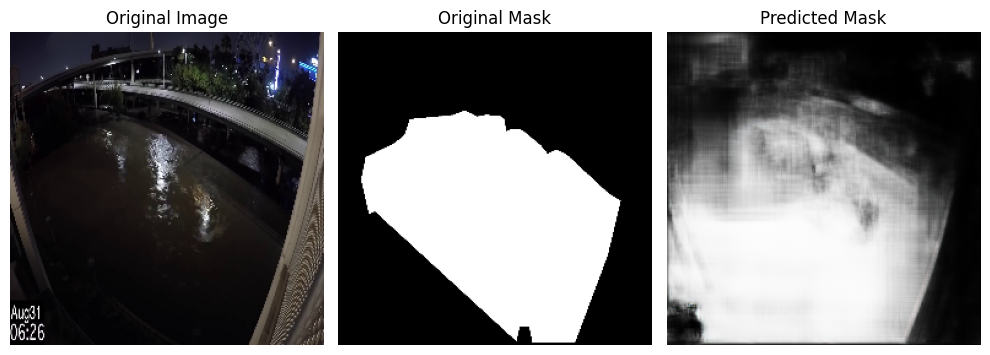

112/112 [==============================] - 48s 431ms/step - loss: 0.0945 - val_loss: 0.4632
Epoch 96/200
112/112 [==============================] - ETA: 0s - loss: 0.0882

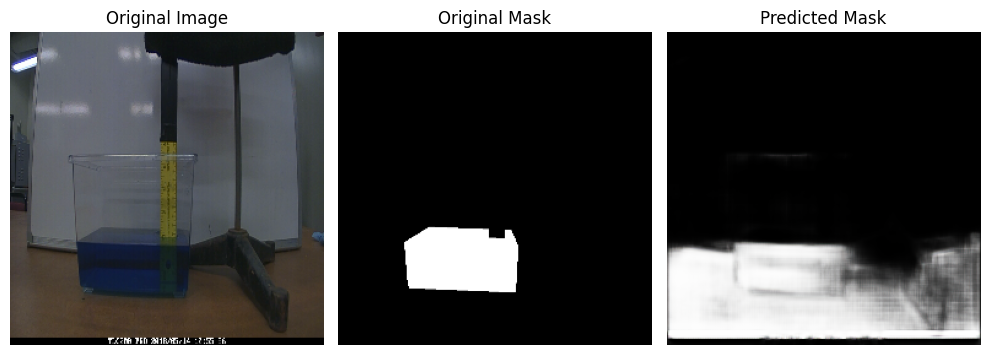

112/112 [==============================] - 48s 430ms/step - loss: 0.0882 - val_loss: 0.3946
Epoch 97/200
112/112 [==============================] - ETA: 0s - loss: 0.0855

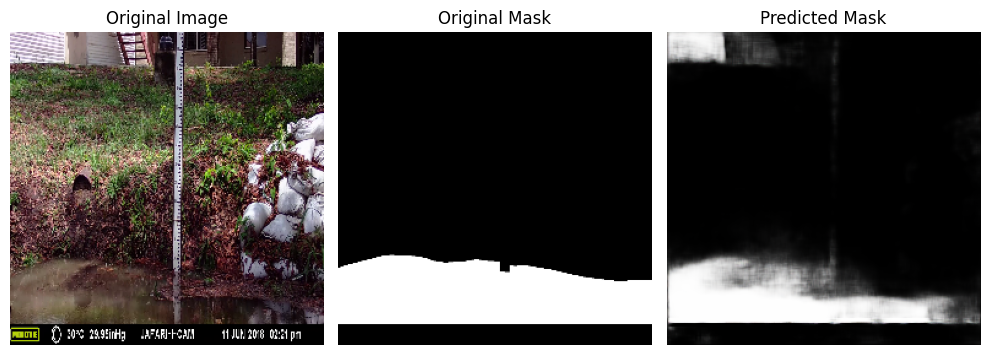

112/112 [==============================] - 48s 431ms/step - loss: 0.0855 - val_loss: 0.5279
Epoch 98/200
112/112 [==============================] - ETA: 0s - loss: 0.0879

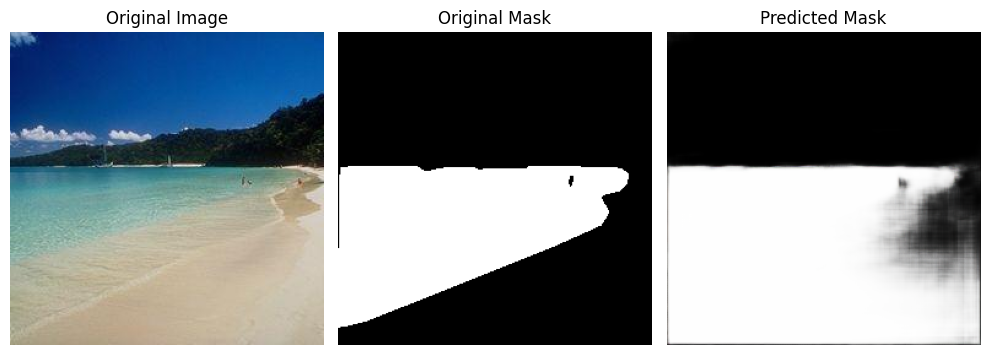

112/112 [==============================] - 48s 430ms/step - loss: 0.0879 - val_loss: 0.5399
Epoch 99/200
112/112 [==============================] - ETA: 0s - loss: 0.0884

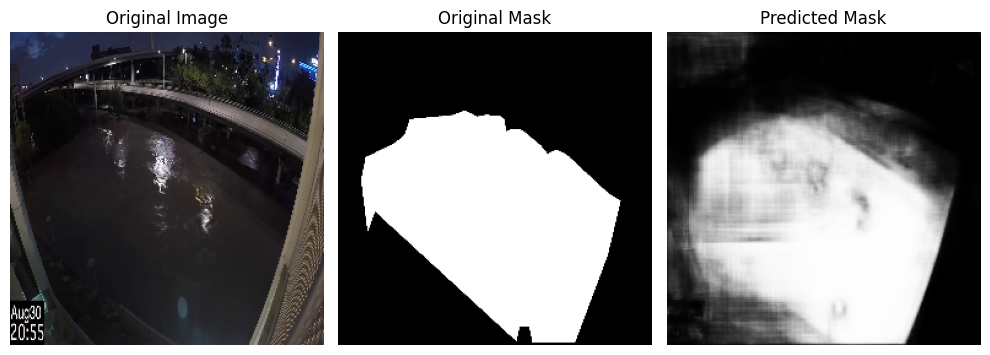

112/112 [==============================] - 48s 431ms/step - loss: 0.0884 - val_loss: 0.4442
Epoch 100/200
112/112 [==============================] - ETA: 0s - loss: 0.0855

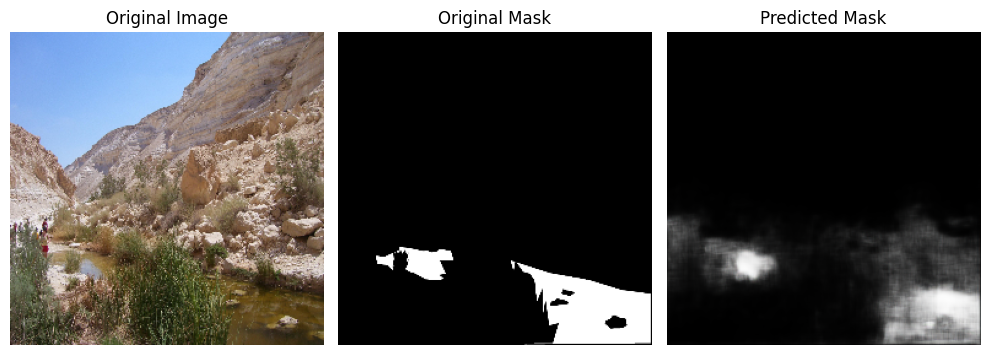

112/112 [==============================] - 48s 430ms/step - loss: 0.0855 - val_loss: 0.4066
Epoch 101/200
112/112 [==============================] - ETA: 0s - loss: 0.0879

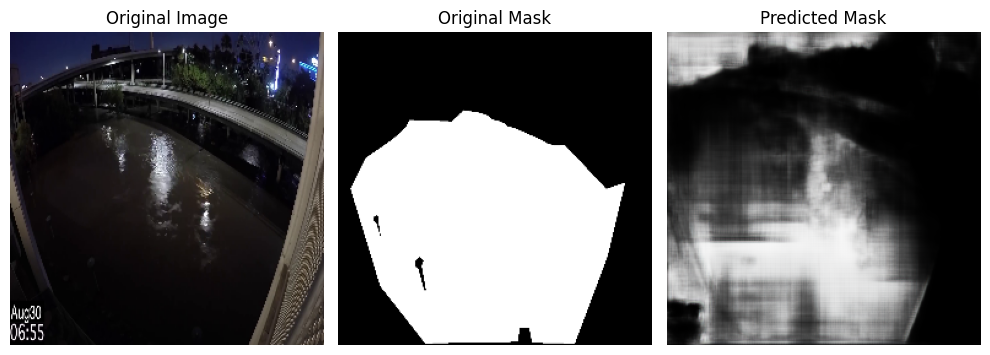

112/112 [==============================] - 48s 431ms/step - loss: 0.0879 - val_loss: 0.5062
Epoch 102/200
112/112 [==============================] - ETA: 0s - loss: 0.0803

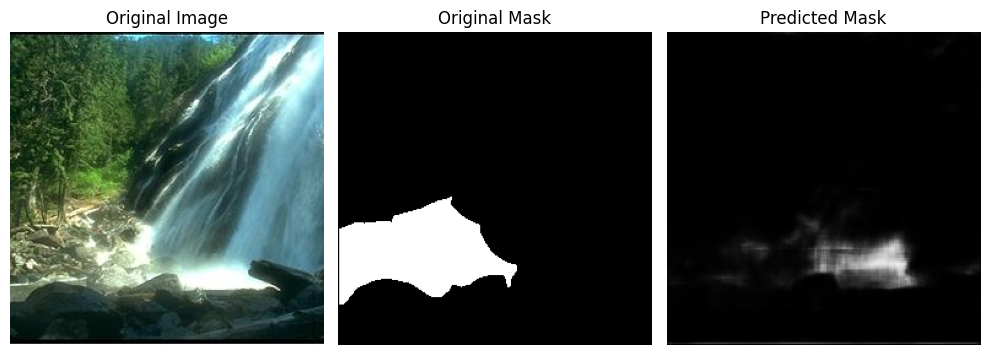

112/112 [==============================] - 48s 430ms/step - loss: 0.0803 - val_loss: 0.7385
Epoch 103/200
112/112 [==============================] - ETA: 0s - loss: 0.0983

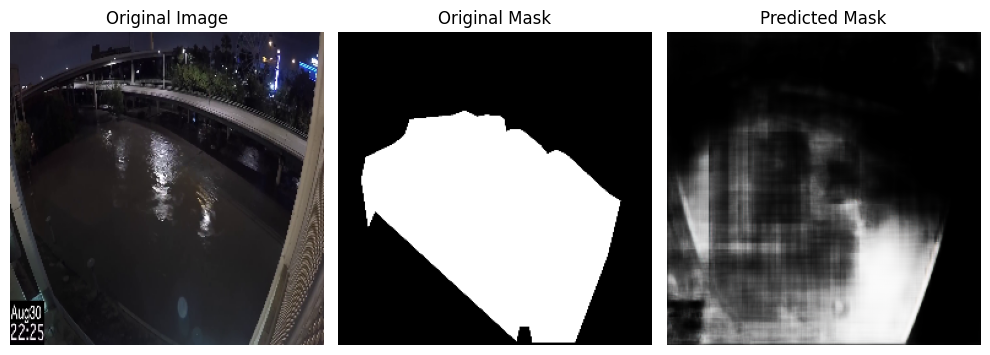

112/112 [==============================] - 48s 430ms/step - loss: 0.0983 - val_loss: 0.4955
Epoch 104/200
112/112 [==============================] - ETA: 0s - loss: 0.1055

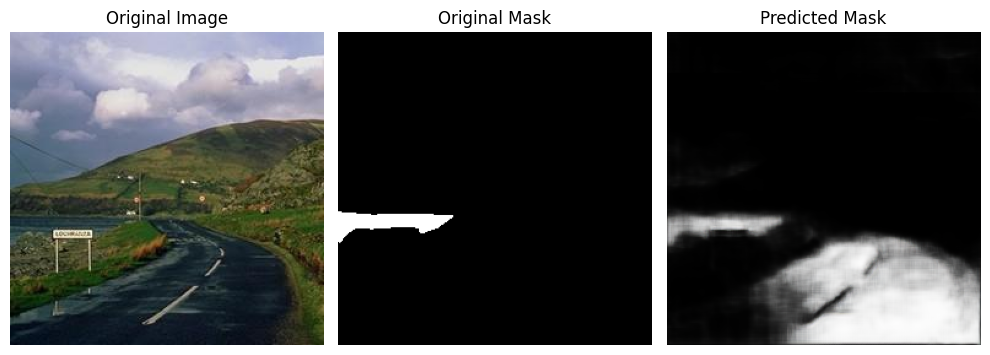

112/112 [==============================] - 48s 431ms/step - loss: 0.1055 - val_loss: 0.4476
Epoch 105/200
112/112 [==============================] - ETA: 0s - loss: 0.0816

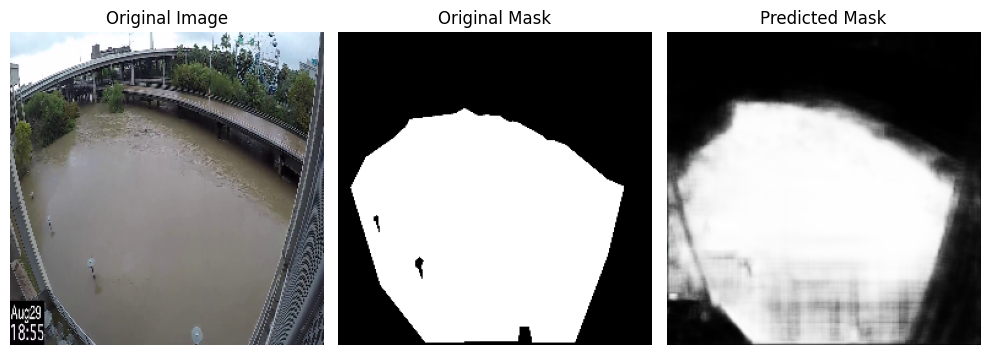

112/112 [==============================] - 48s 431ms/step - loss: 0.0816 - val_loss: 0.4624
Epoch 106/200
112/112 [==============================] - ETA: 0s - loss: 0.0854

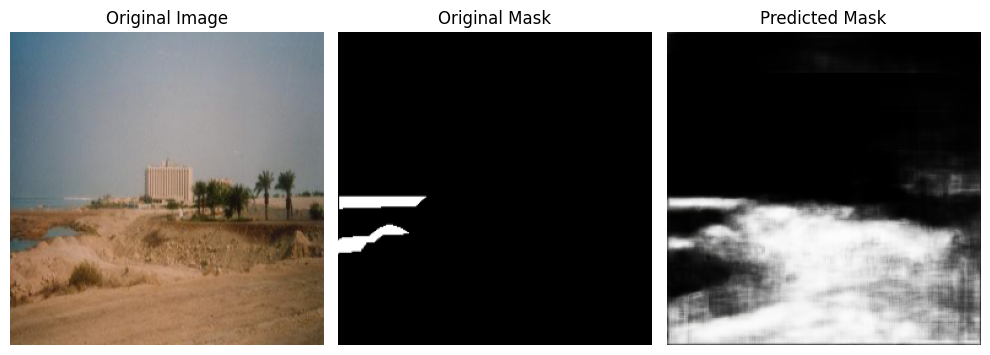

112/112 [==============================] - 48s 431ms/step - loss: 0.0854 - val_loss: 0.4750
Epoch 107/200
112/112 [==============================] - ETA: 0s - loss: 0.0805

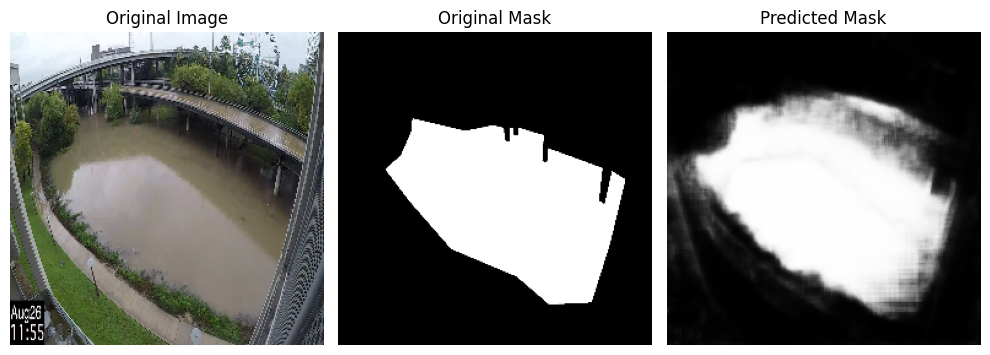

112/112 [==============================] - 48s 430ms/step - loss: 0.0805 - val_loss: 0.4849
Epoch 108/200
112/112 [==============================] - ETA: 0s - loss: 0.0703

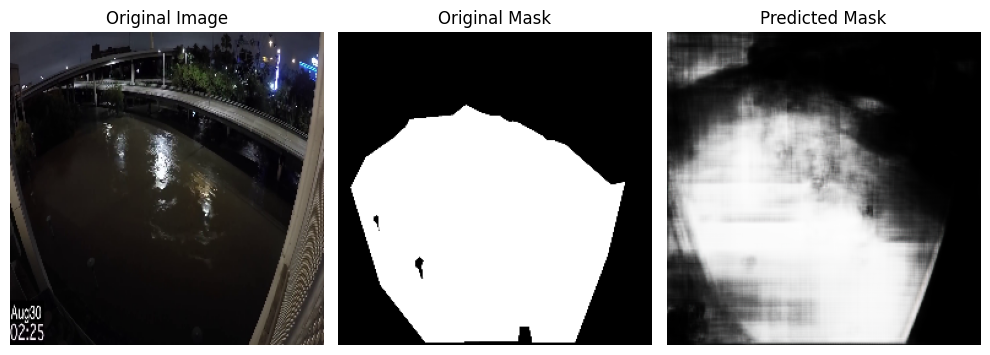

112/112 [==============================] - 48s 431ms/step - loss: 0.0703 - val_loss: 0.4769
Epoch 109/200
112/112 [==============================] - ETA: 0s - loss: 0.0801

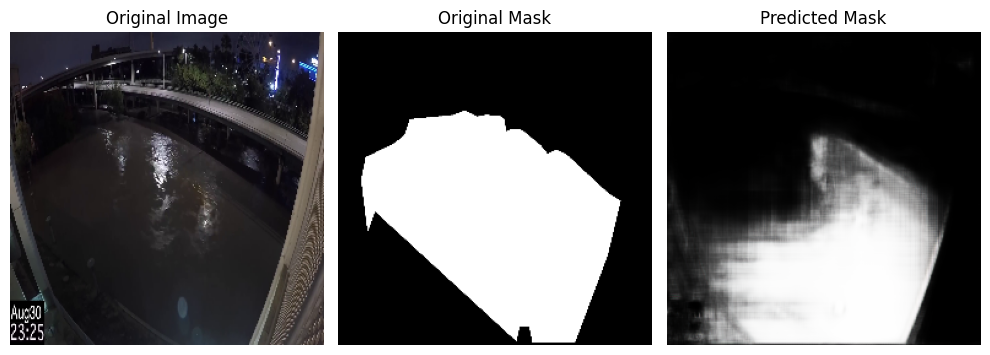

112/112 [==============================] - 49s 434ms/step - loss: 0.0801 - val_loss: 0.6363
Epoch 110/200
112/112 [==============================] - ETA: 0s - loss: 0.0729

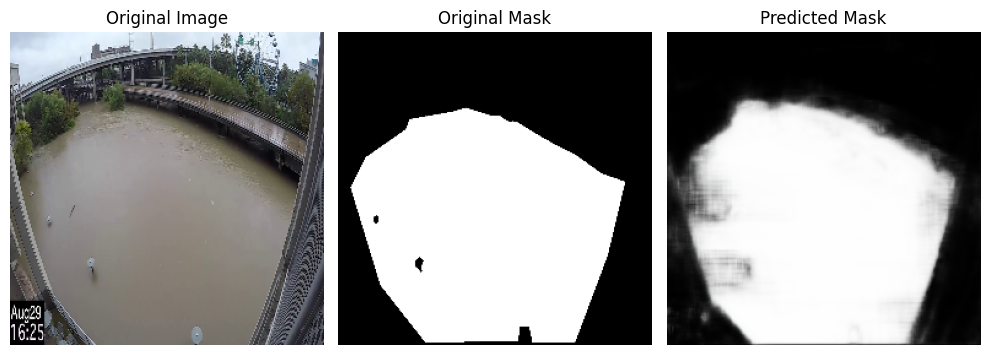

112/112 [==============================] - 48s 430ms/step - loss: 0.0729 - val_loss: 0.5219
Epoch 111/200
112/112 [==============================] - ETA: 0s - loss: 0.0787

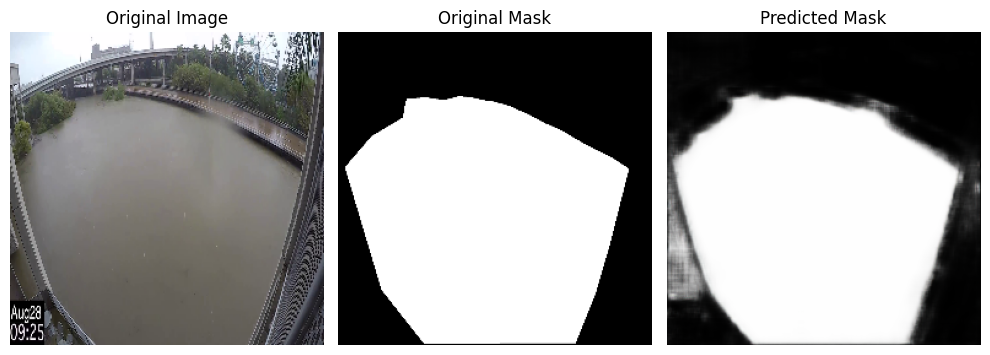

112/112 [==============================] - 48s 431ms/step - loss: 0.0787 - val_loss: 0.4821
Epoch 112/200
112/112 [==============================] - ETA: 0s - loss: 0.0836

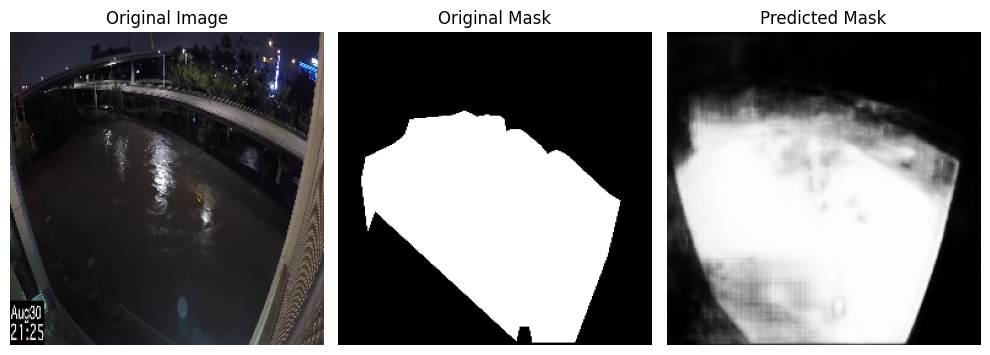

112/112 [==============================] - 48s 431ms/step - loss: 0.0836 - val_loss: 0.4548
Epoch 113/200
112/112 [==============================] - ETA: 0s - loss: 0.0677

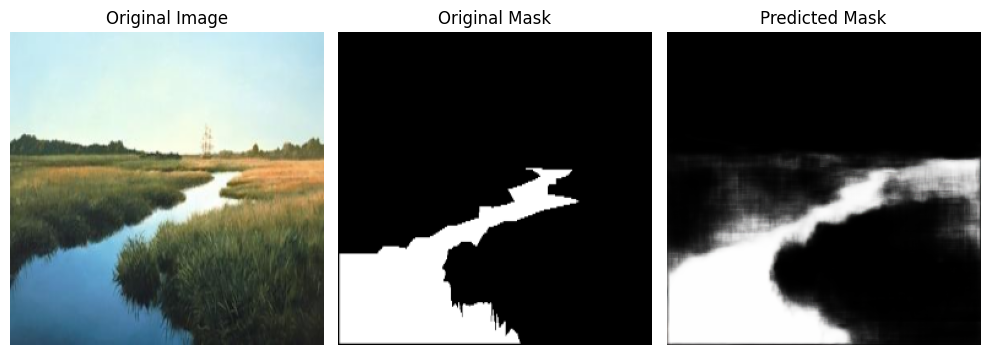

112/112 [==============================] - 48s 432ms/step - loss: 0.0677 - val_loss: 0.5276
Epoch 114/200
112/112 [==============================] - ETA: 0s - loss: 0.0658

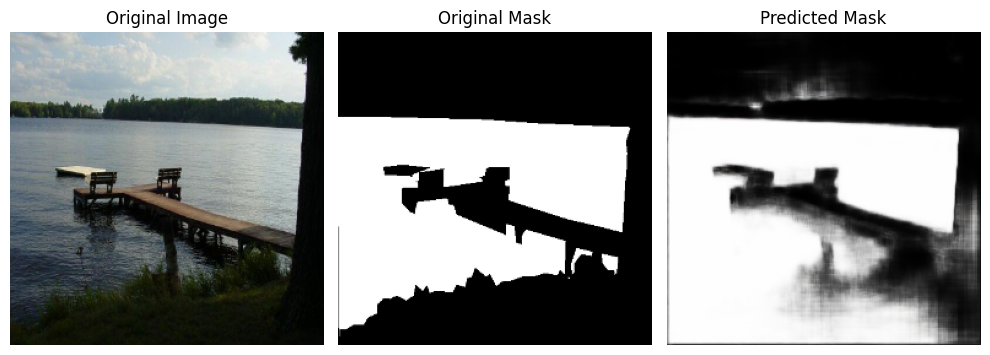

112/112 [==============================] - 48s 432ms/step - loss: 0.0658 - val_loss: 0.5115
Epoch 115/200
112/112 [==============================] - ETA: 0s - loss: 0.0696

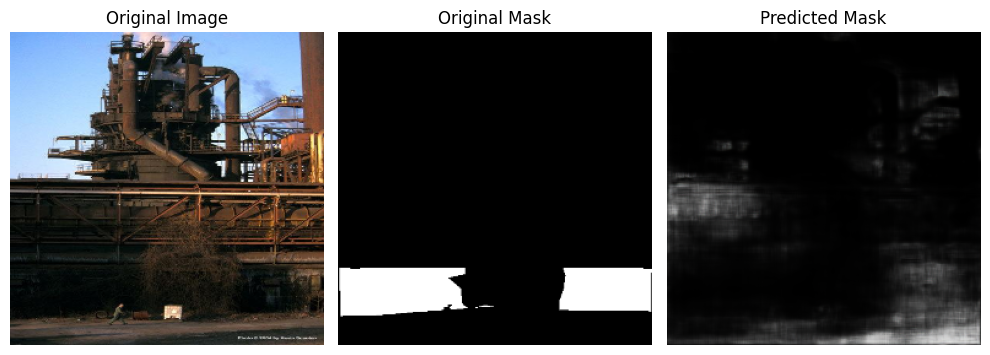

112/112 [==============================] - 48s 432ms/step - loss: 0.0696 - val_loss: 0.4427
Epoch 116/200
112/112 [==============================] - ETA: 0s - loss: 0.1151

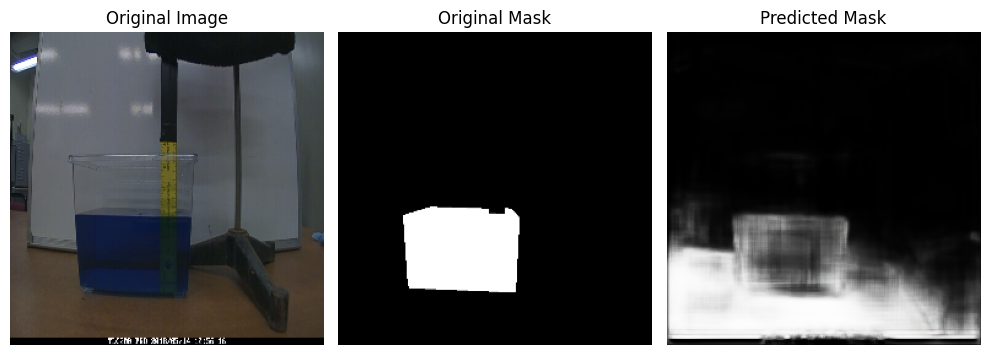

112/112 [==============================] - 48s 431ms/step - loss: 0.1151 - val_loss: 0.4224
Epoch 117/200
112/112 [==============================] - ETA: 0s - loss: 0.1415

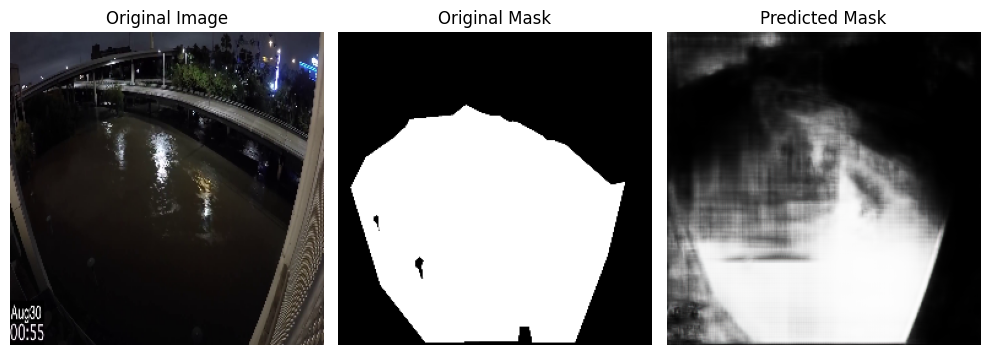

112/112 [==============================] - 48s 431ms/step - loss: 0.1415 - val_loss: 0.5421
Epoch 118/200
112/112 [==============================] - ETA: 0s - loss: 0.0811

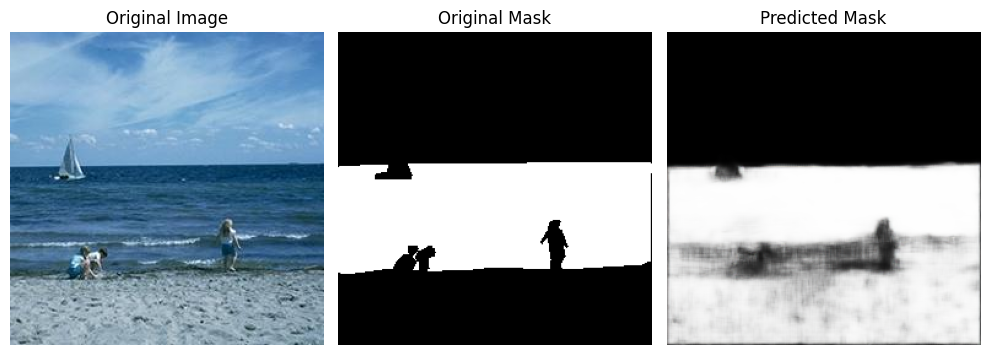

112/112 [==============================] - 48s 431ms/step - loss: 0.0811 - val_loss: 0.4527
Epoch 119/200
112/112 [==============================] - ETA: 0s - loss: 0.0801

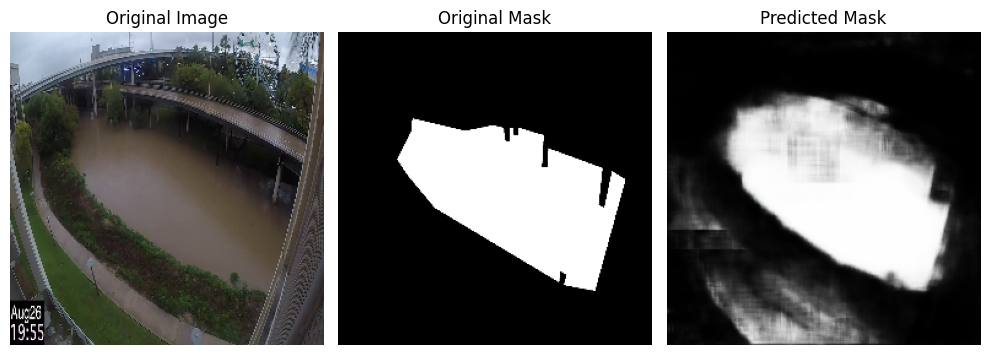

112/112 [==============================] - 48s 431ms/step - loss: 0.0801 - val_loss: 0.4993
Epoch 120/200
112/112 [==============================] - ETA: 0s - loss: 0.0706

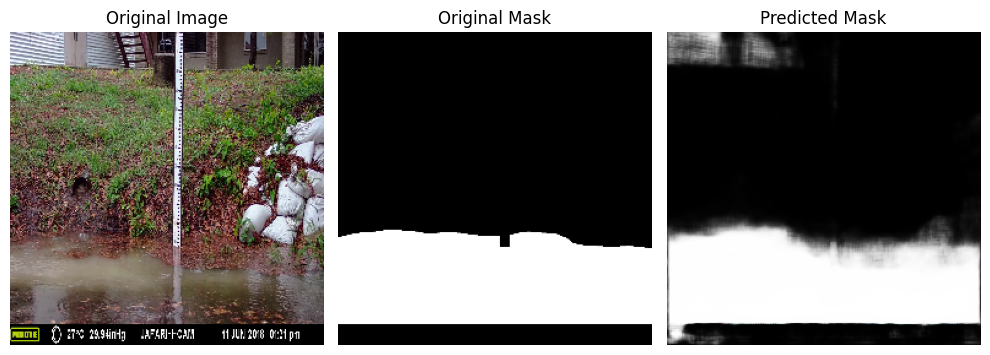

112/112 [==============================] - 48s 431ms/step - loss: 0.0706 - val_loss: 0.5164
Epoch 121/200
112/112 [==============================] - ETA: 0s - loss: 0.0649

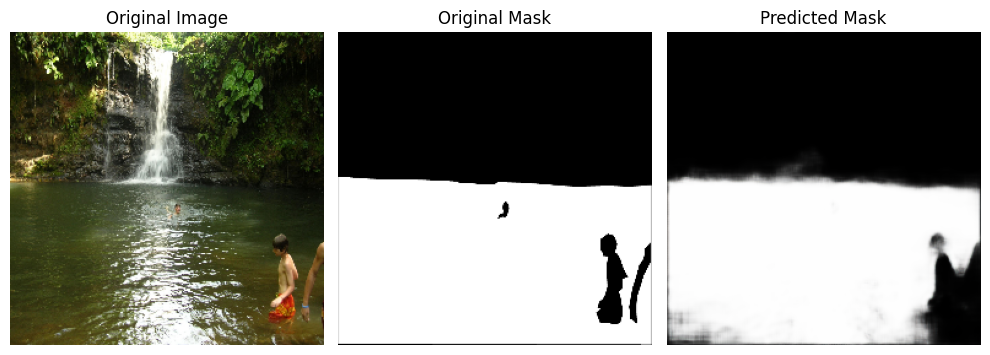

112/112 [==============================] - 48s 430ms/step - loss: 0.0649 - val_loss: 0.5918
Epoch 122/200
112/112 [==============================] - ETA: 0s - loss: 0.0643

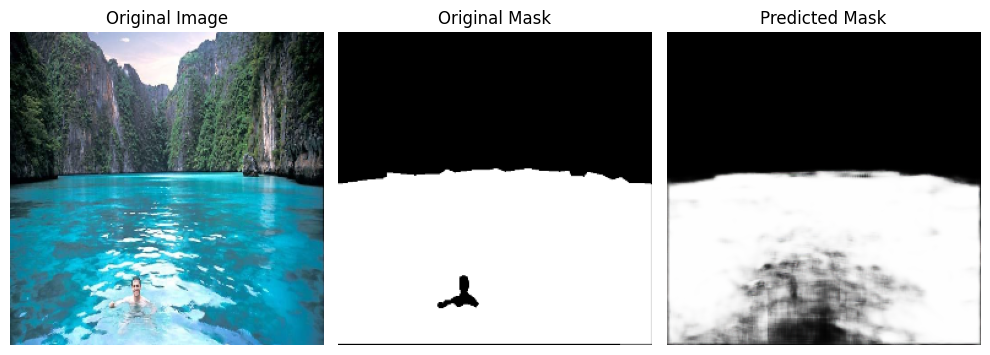

112/112 [==============================] - 48s 431ms/step - loss: 0.0643 - val_loss: 0.5240
Epoch 123/200
112/112 [==============================] - ETA: 0s - loss: 0.0724

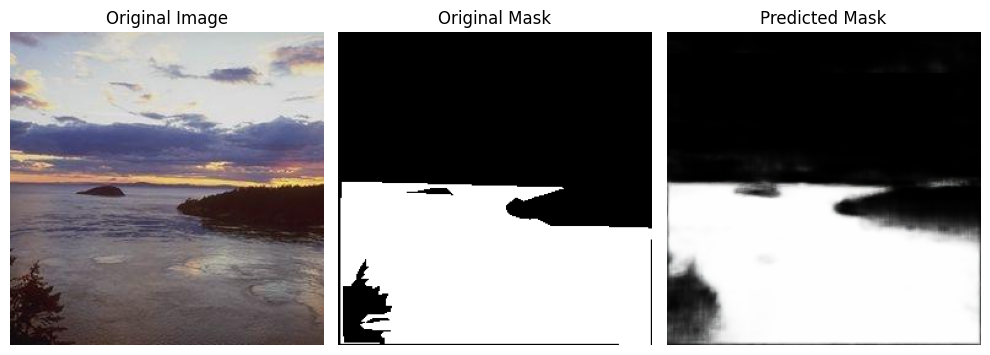

112/112 [==============================] - 48s 430ms/step - loss: 0.0724 - val_loss: 0.5237
Epoch 124/200
112/112 [==============================] - ETA: 0s - loss: 0.0811

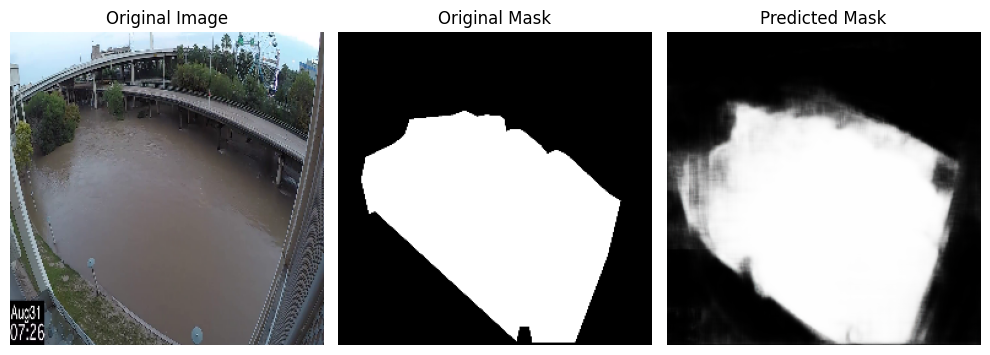

112/112 [==============================] - 48s 433ms/step - loss: 0.0811 - val_loss: 0.4555
Epoch 125/200
112/112 [==============================] - ETA: 0s - loss: 0.0665

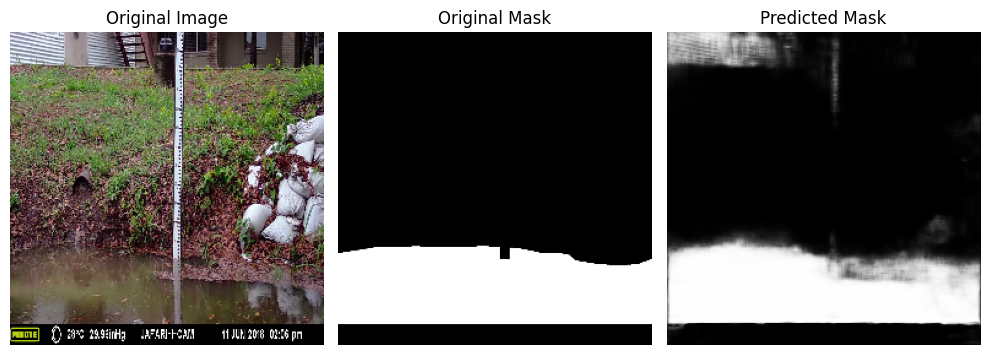

112/112 [==============================] - 48s 431ms/step - loss: 0.0665 - val_loss: 0.4481
Epoch 126/200
112/112 [==============================] - ETA: 0s - loss: 0.0680

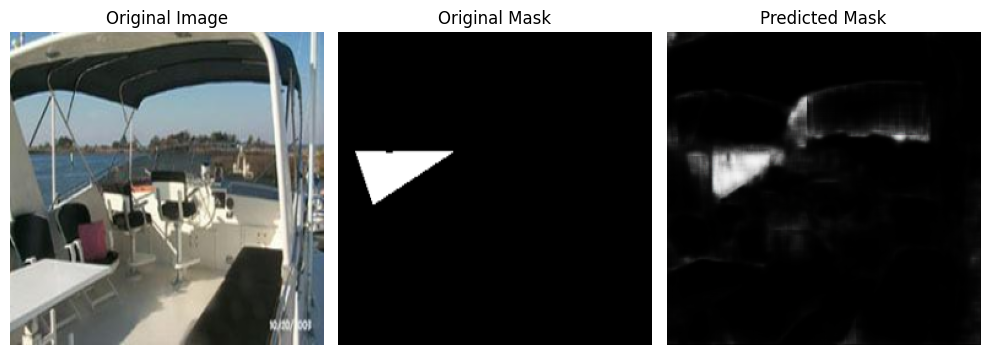

112/112 [==============================] - 48s 430ms/step - loss: 0.0680 - val_loss: 0.5920
Epoch 127/200
112/112 [==============================] - ETA: 0s - loss: 0.0655

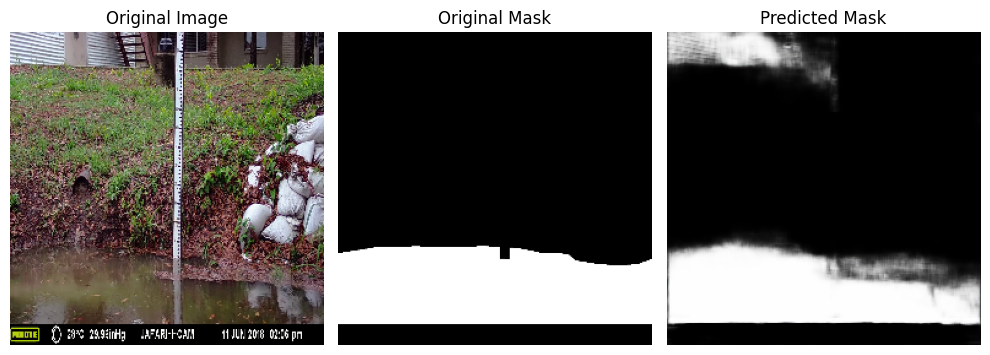

112/112 [==============================] - 48s 430ms/step - loss: 0.0655 - val_loss: 0.5533
Epoch 128/200
112/112 [==============================] - ETA: 0s - loss: 0.0593

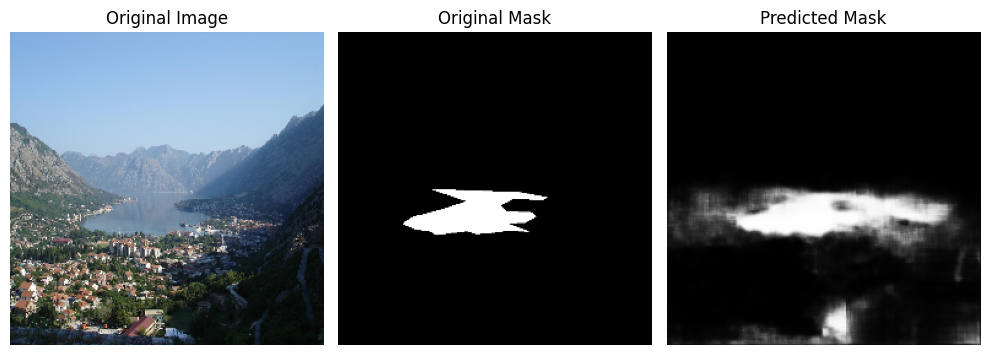

112/112 [==============================] - 48s 431ms/step - loss: 0.0593 - val_loss: 0.5559
Epoch 129/200
112/112 [==============================] - ETA: 0s - loss: 0.0561

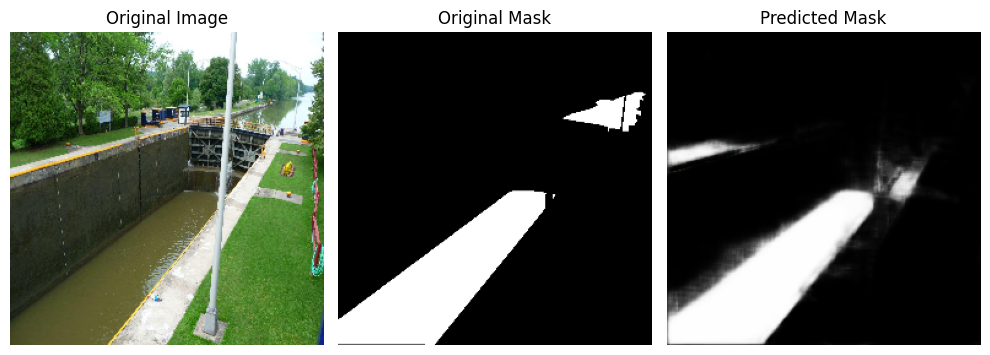

112/112 [==============================] - 48s 430ms/step - loss: 0.0561 - val_loss: 0.5330
Epoch 130/200
112/112 [==============================] - ETA: 0s - loss: 0.0546

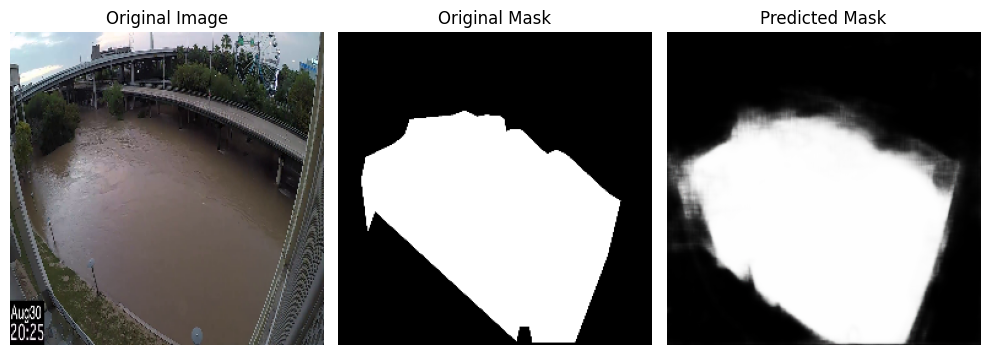

112/112 [==============================] - 48s 430ms/step - loss: 0.0546 - val_loss: 0.6169
Epoch 131/200
112/112 [==============================] - ETA: 0s - loss: 0.0539

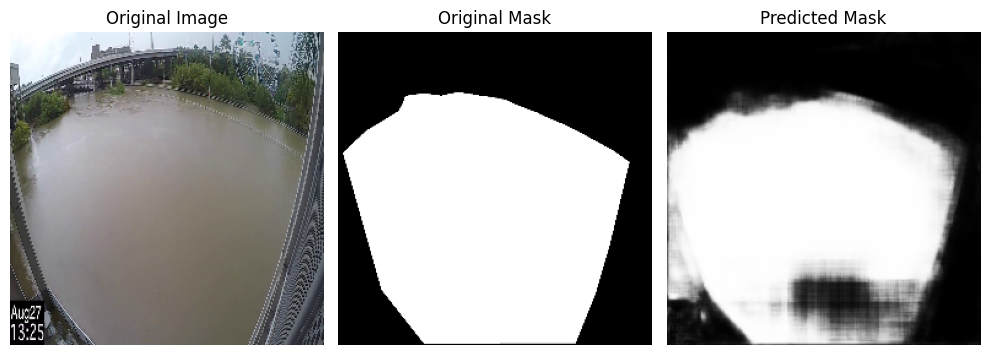

112/112 [==============================] - 48s 432ms/step - loss: 0.0539 - val_loss: 0.6014
Epoch 132/200
112/112 [==============================] - ETA: 0s - loss: 0.0545

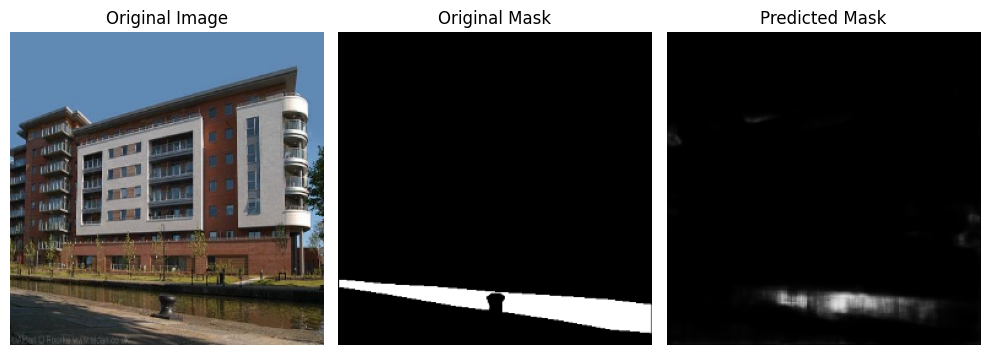

112/112 [==============================] - 48s 430ms/step - loss: 0.0545 - val_loss: 0.5801
Epoch 133/200
112/112 [==============================] - ETA: 0s - loss: 0.0718

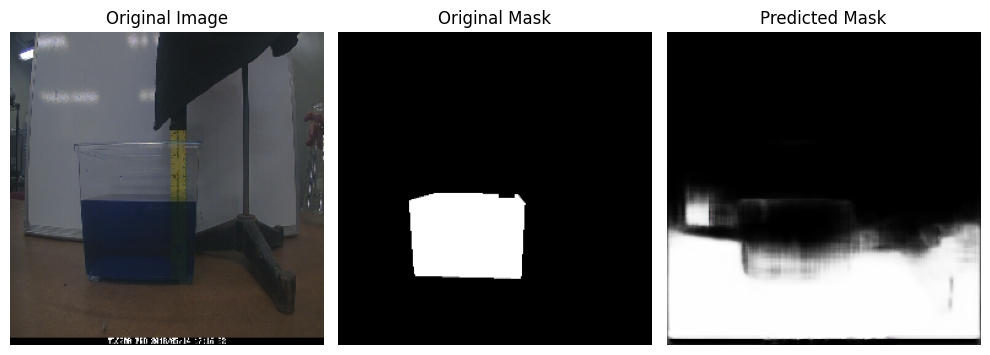

112/112 [==============================] - 48s 430ms/step - loss: 0.0718 - val_loss: 0.6009
Epoch 134/200
112/112 [==============================] - ETA: 0s - loss: 0.0616

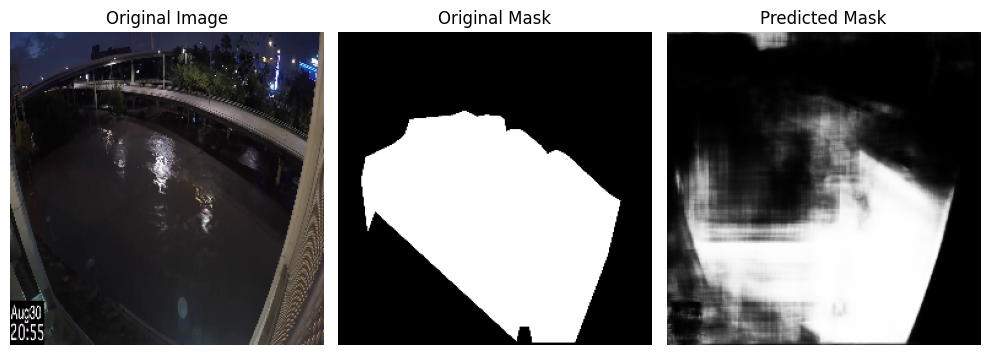

112/112 [==============================] - 48s 430ms/step - loss: 0.0616 - val_loss: 0.5744
Epoch 135/200
112/112 [==============================] - ETA: 0s - loss: 0.0562

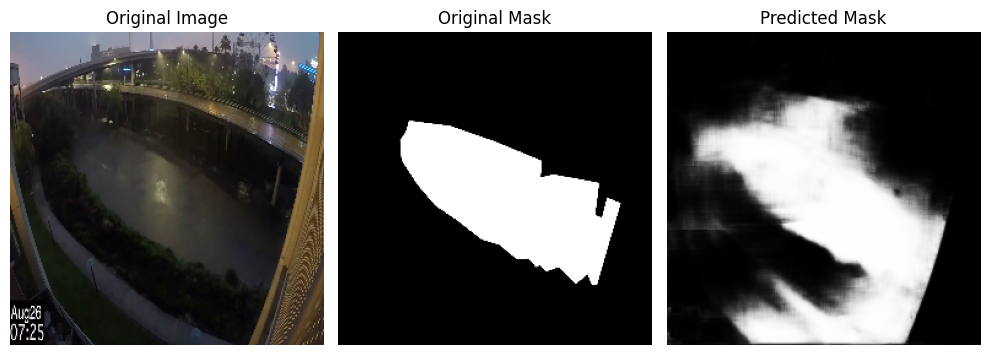

112/112 [==============================] - 48s 430ms/step - loss: 0.0562 - val_loss: 0.5289
Epoch 136/200
112/112 [==============================] - ETA: 0s - loss: 0.0605

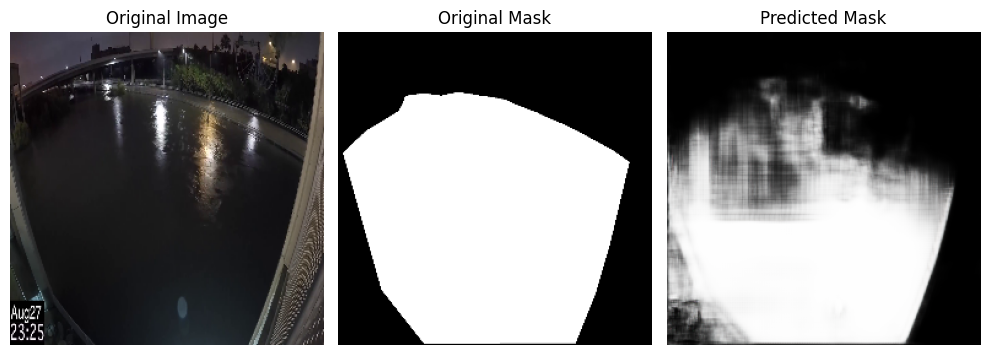

112/112 [==============================] - 48s 431ms/step - loss: 0.0605 - val_loss: 0.5241
Epoch 137/200
112/112 [==============================] - ETA: 0s - loss: 0.0723

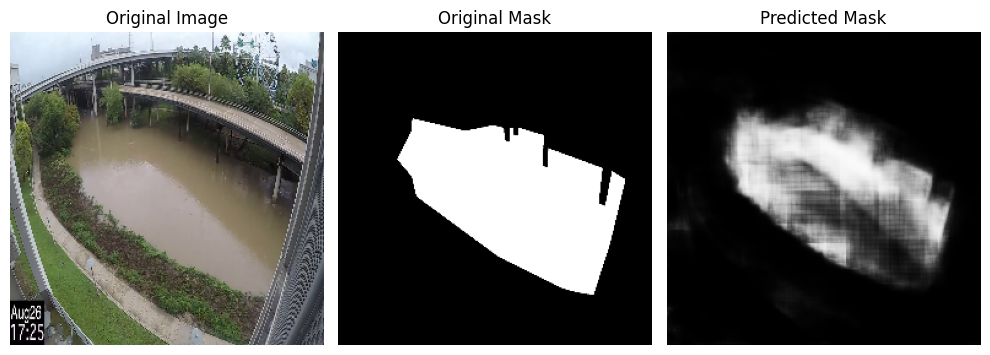

112/112 [==============================] - 48s 430ms/step - loss: 0.0723 - val_loss: 0.5854
Epoch 138/200
112/112 [==============================] - ETA: 0s - loss: 0.0680

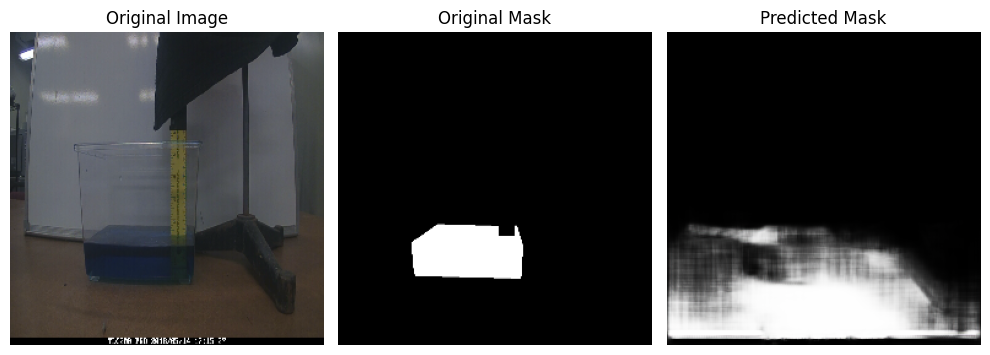

112/112 [==============================] - 48s 430ms/step - loss: 0.0680 - val_loss: 0.6178
Epoch 139/200
112/112 [==============================] - ETA: 0s - loss: 0.0720

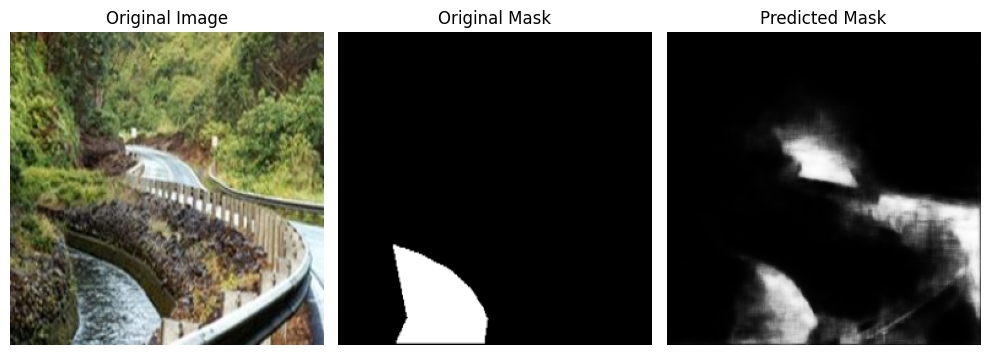

112/112 [==============================] - 49s 434ms/step - loss: 0.0720 - val_loss: 0.5411
Epoch 140/200
112/112 [==============================] - ETA: 0s - loss: 0.0742

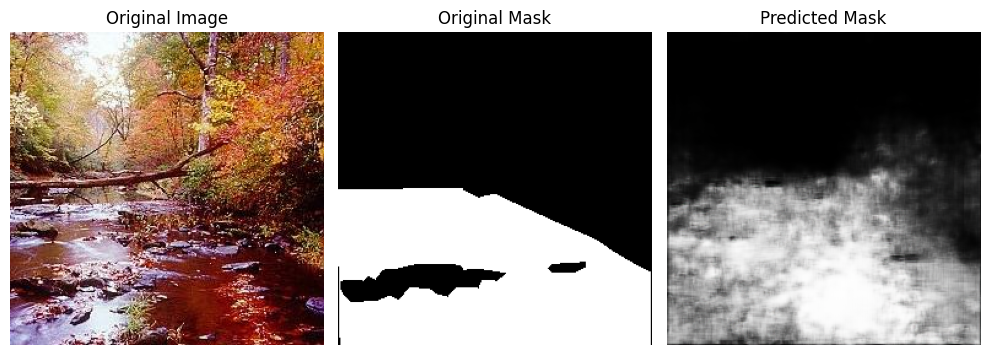

112/112 [==============================] - 48s 431ms/step - loss: 0.0742 - val_loss: 0.4810
Epoch 141/200
112/112 [==============================] - ETA: 0s - loss: 0.0840

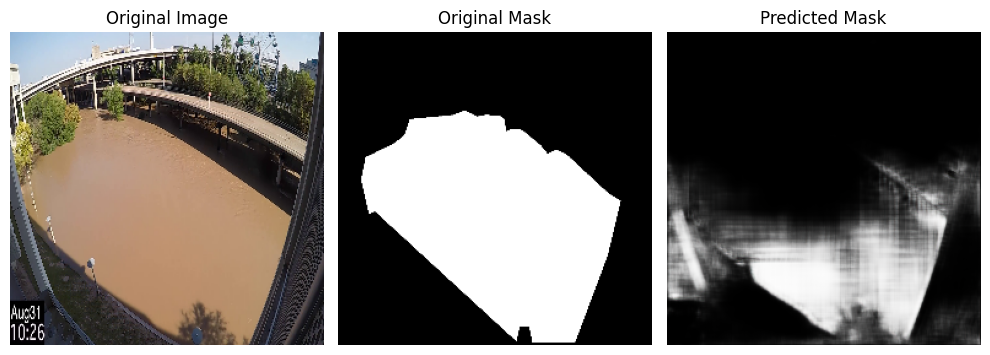

112/112 [==============================] - 48s 431ms/step - loss: 0.0840 - val_loss: 0.6796
Epoch 142/200
112/112 [==============================] - ETA: 0s - loss: 0.0582

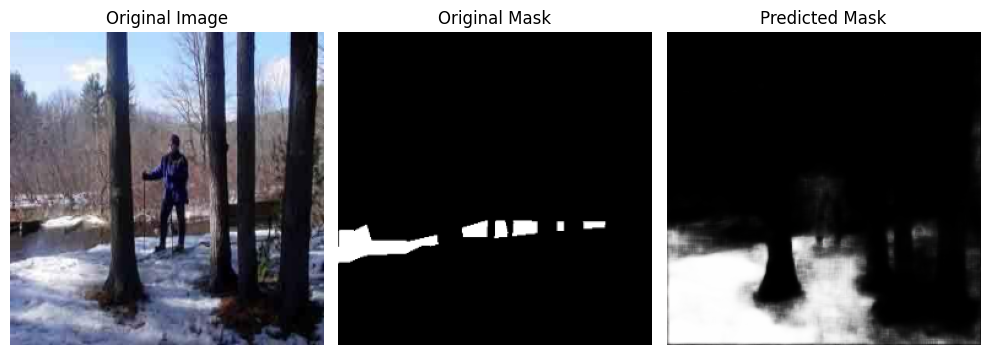

112/112 [==============================] - 48s 431ms/step - loss: 0.0582 - val_loss: 0.5566
Epoch 143/200
112/112 [==============================] - ETA: 0s - loss: 0.0547

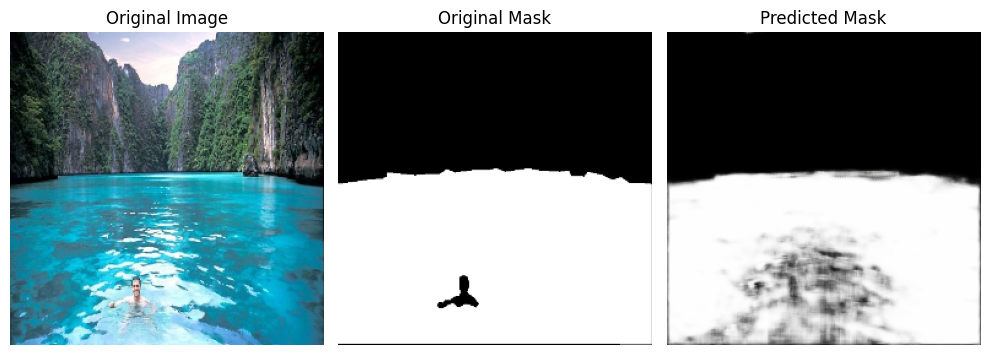

112/112 [==============================] - 48s 431ms/step - loss: 0.0547 - val_loss: 0.5913
Epoch 144/200
112/112 [==============================] - ETA: 0s - loss: 0.0643

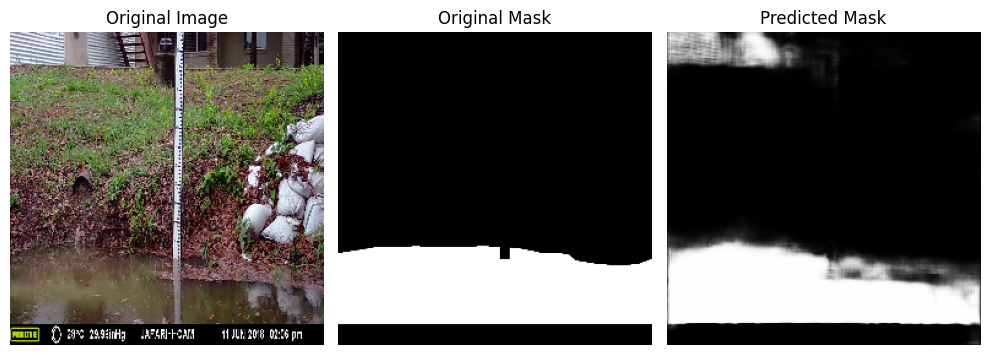

112/112 [==============================] - 48s 431ms/step - loss: 0.0643 - val_loss: 0.5692
Epoch 145/200
112/112 [==============================] - ETA: 0s - loss: 0.0518

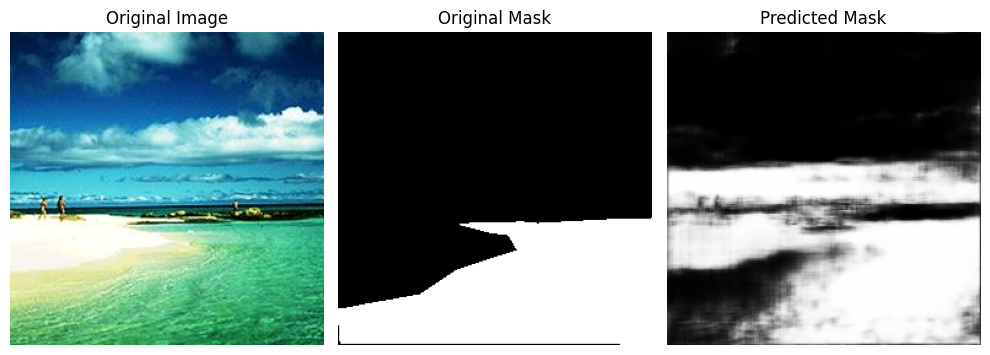

112/112 [==============================] - 48s 431ms/step - loss: 0.0518 - val_loss: 0.5534
Epoch 146/200
112/112 [==============================] - ETA: 0s - loss: 0.0479

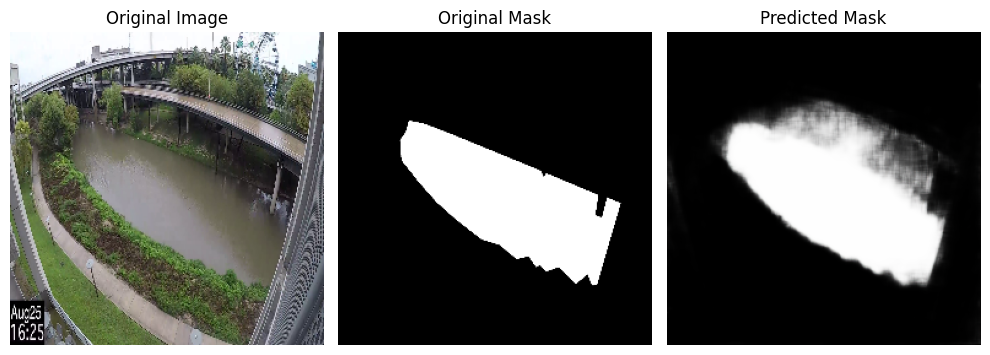

112/112 [==============================] - 48s 430ms/step - loss: 0.0479 - val_loss: 0.5457
Epoch 147/200
112/112 [==============================] - ETA: 0s - loss: 0.0507

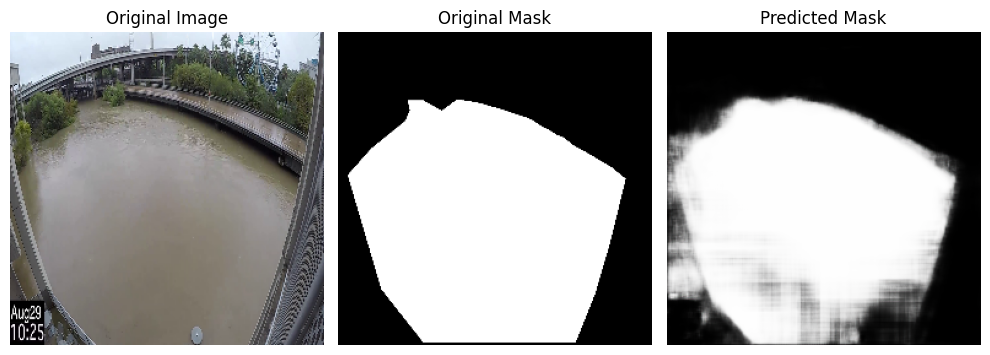

112/112 [==============================] - 48s 431ms/step - loss: 0.0507 - val_loss: 0.6052
Epoch 148/200
112/112 [==============================] - ETA: 0s - loss: 0.0634

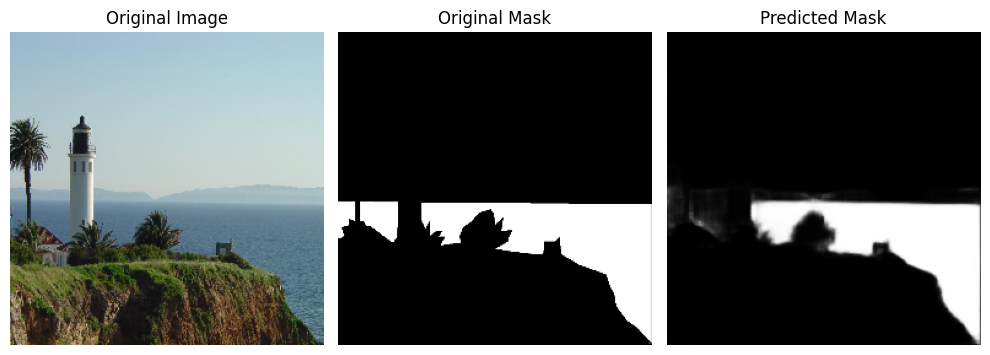

112/112 [==============================] - 48s 432ms/step - loss: 0.0634 - val_loss: 0.6372
Epoch 149/200
112/112 [==============================] - ETA: 0s - loss: 0.0647

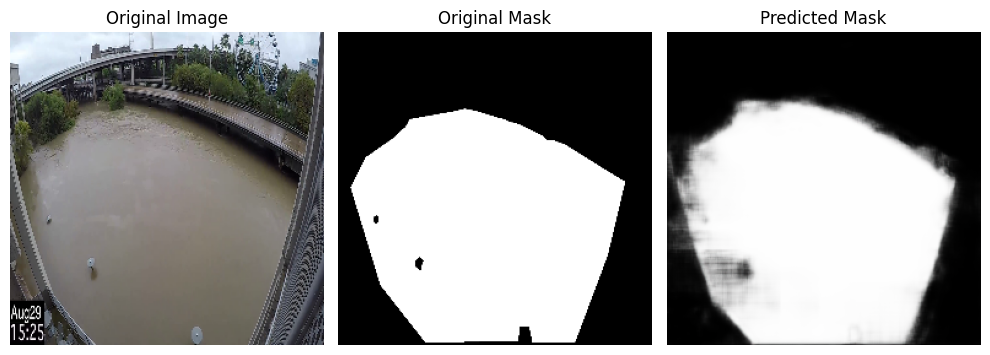

112/112 [==============================] - 48s 431ms/step - loss: 0.0647 - val_loss: 0.5574
Epoch 150/200
112/112 [==============================] - ETA: 0s - loss: 0.0666

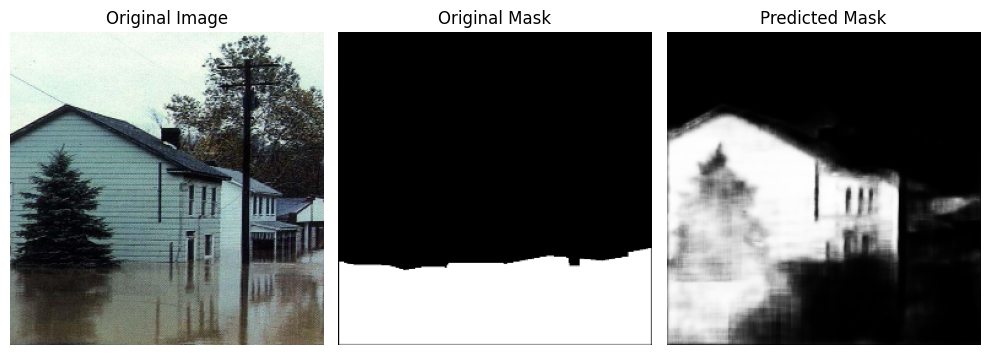

112/112 [==============================] - 48s 431ms/step - loss: 0.0666 - val_loss: 0.5742
Epoch 151/200
112/112 [==============================] - ETA: 0s - loss: 0.0520

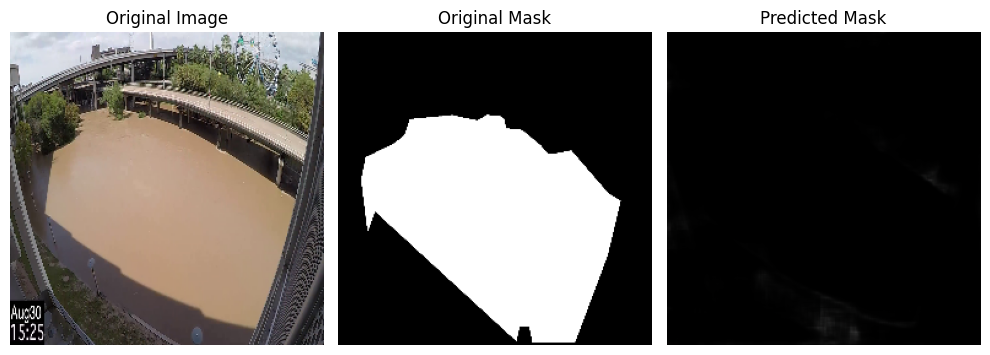

112/112 [==============================] - 48s 431ms/step - loss: 0.0520 - val_loss: 0.5572
Epoch 152/200
112/112 [==============================] - ETA: 0s - loss: 0.0487

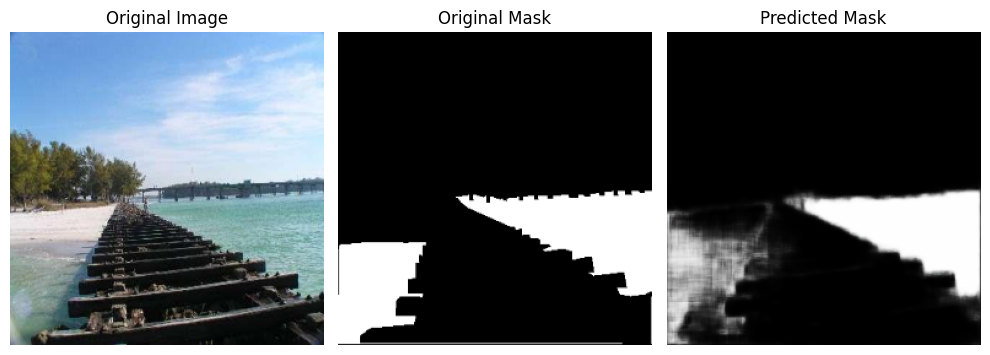

112/112 [==============================] - 48s 431ms/step - loss: 0.0487 - val_loss: 0.6084
Epoch 153/200
112/112 [==============================] - ETA: 0s - loss: 0.0506

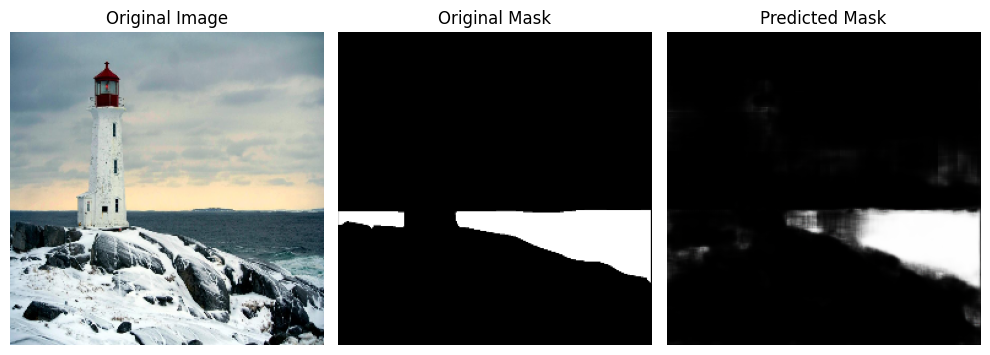

112/112 [==============================] - 48s 431ms/step - loss: 0.0506 - val_loss: 0.5779
Epoch 154/200
112/112 [==============================] - ETA: 0s - loss: 0.0502

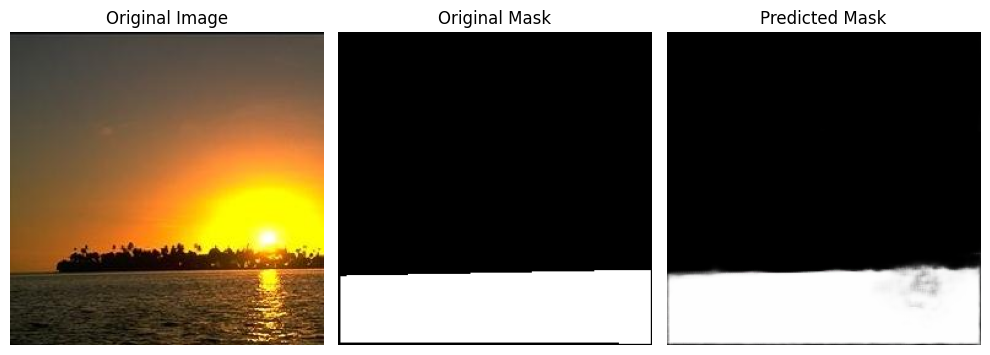

112/112 [==============================] - 48s 430ms/step - loss: 0.0502 - val_loss: 0.6207
Epoch 155/200
112/112 [==============================] - ETA: 0s - loss: 0.0454

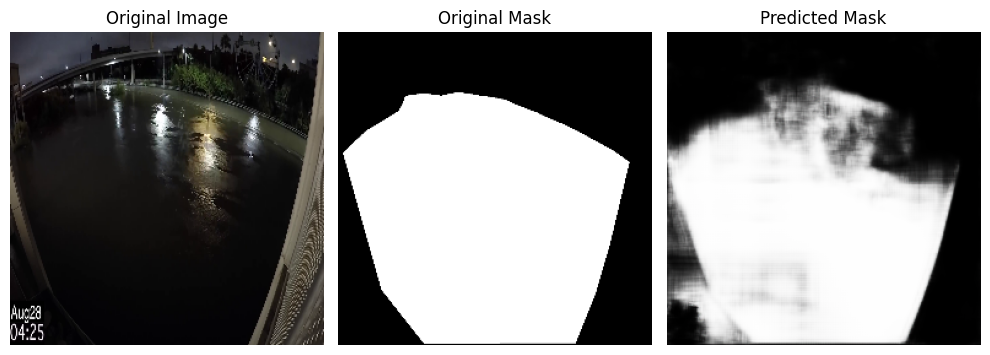

112/112 [==============================] - 48s 432ms/step - loss: 0.0454 - val_loss: 0.6226
Epoch 156/200
112/112 [==============================] - ETA: 0s - loss: 0.0447

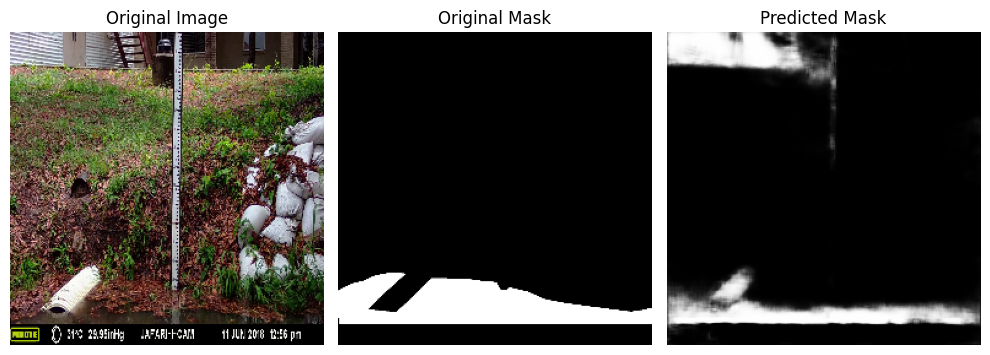

112/112 [==============================] - 48s 430ms/step - loss: 0.0447 - val_loss: 0.6548
Epoch 157/200
112/112 [==============================] - ETA: 0s - loss: 0.0428

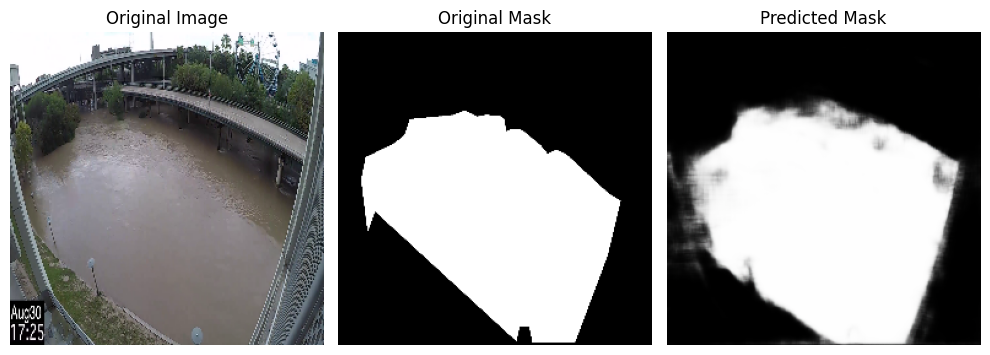

112/112 [==============================] - 48s 430ms/step - loss: 0.0428 - val_loss: 0.6476
Epoch 158/200
112/112 [==============================] - ETA: 0s - loss: 0.0715

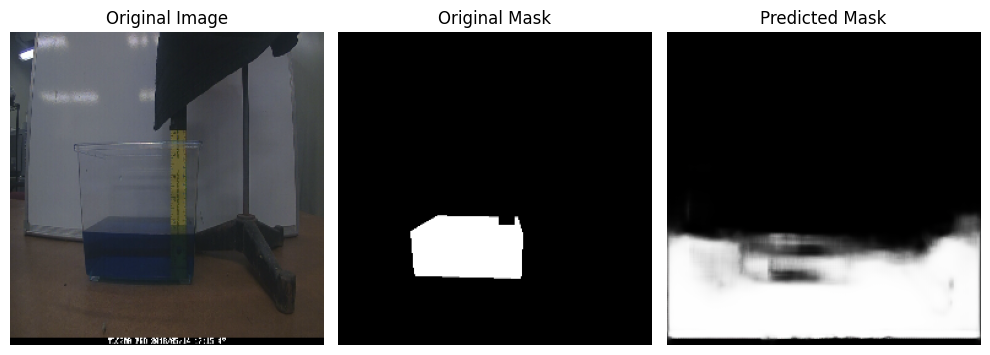

112/112 [==============================] - 48s 431ms/step - loss: 0.0715 - val_loss: 0.6432
Epoch 159/200
112/112 [==============================] - ETA: 0s - loss: 0.0688

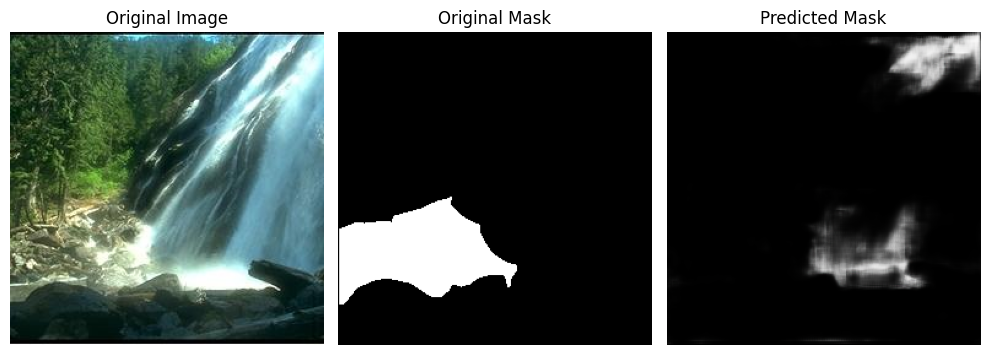

112/112 [==============================] - 48s 432ms/step - loss: 0.0688 - val_loss: 0.5856
Epoch 160/200
112/112 [==============================] - ETA: 0s - loss: 0.0503

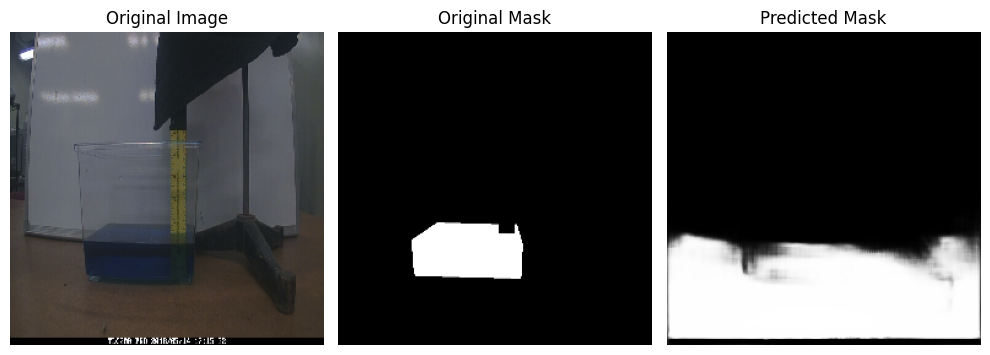

112/112 [==============================] - 48s 432ms/step - loss: 0.0503 - val_loss: 0.5950
Epoch 161/200
112/112 [==============================] - ETA: 0s - loss: 0.0467

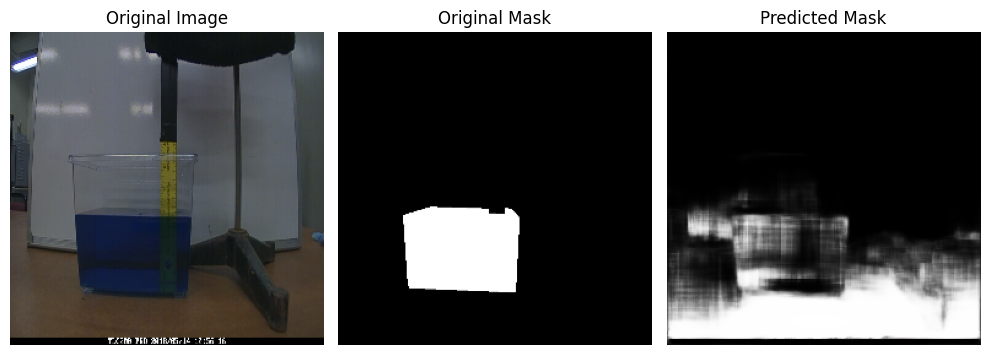

112/112 [==============================] - 48s 431ms/step - loss: 0.0467 - val_loss: 0.6303
Epoch 162/200
112/112 [==============================] - ETA: 0s - loss: 0.0433

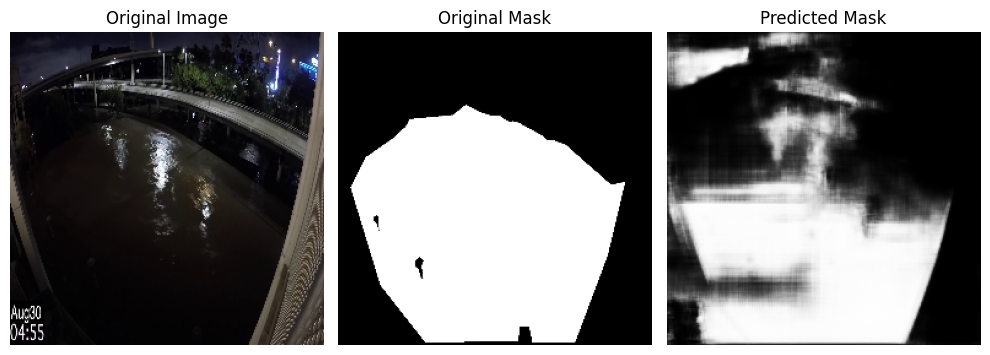

112/112 [==============================] - 48s 430ms/step - loss: 0.0433 - val_loss: 0.6579
Epoch 163/200
112/112 [==============================] - ETA: 0s - loss: 0.0450

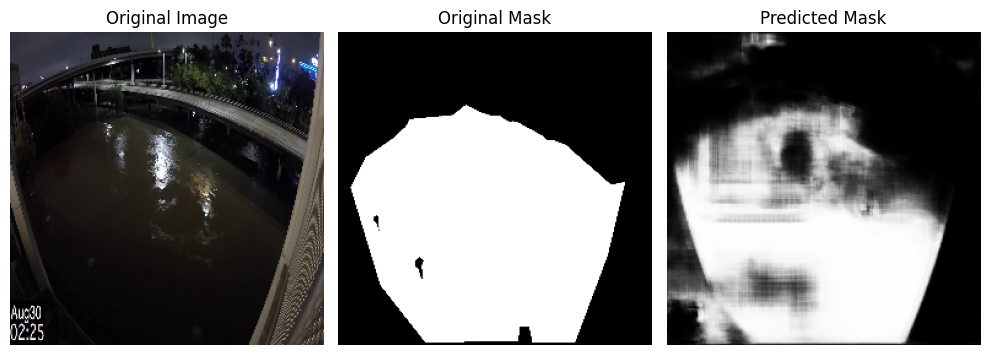

112/112 [==============================] - 48s 431ms/step - loss: 0.0450 - val_loss: 0.7133
Epoch 164/200
112/112 [==============================] - ETA: 0s - loss: 0.0413

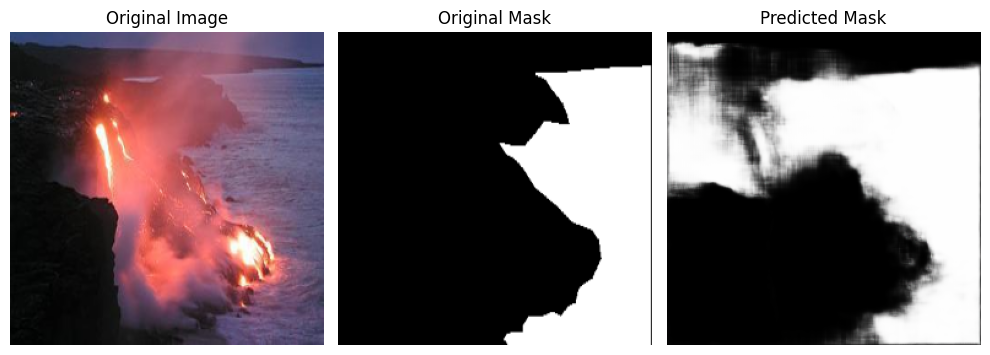

112/112 [==============================] - 48s 430ms/step - loss: 0.0413 - val_loss: 0.6781
Epoch 165/200
112/112 [==============================] - ETA: 0s - loss: 0.0554

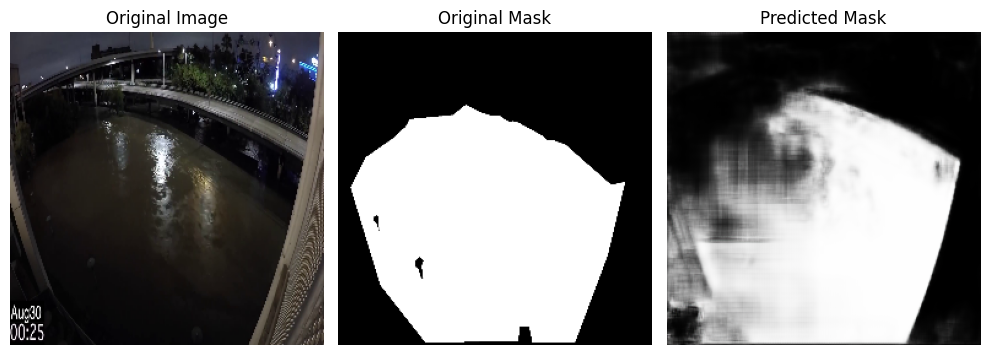

112/112 [==============================] - 48s 431ms/step - loss: 0.0554 - val_loss: 0.5902
Epoch 166/200
112/112 [==============================] - ETA: 0s - loss: 0.0718

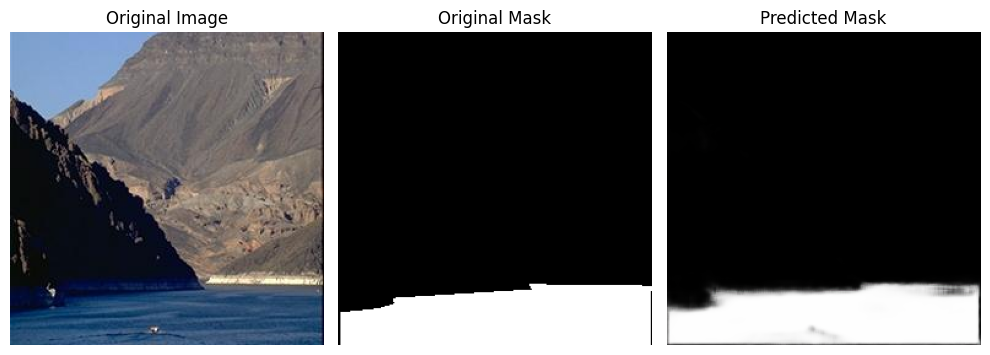

112/112 [==============================] - 48s 430ms/step - loss: 0.0718 - val_loss: 0.6797
Epoch 167/200
112/112 [==============================] - ETA: 0s - loss: 0.0795

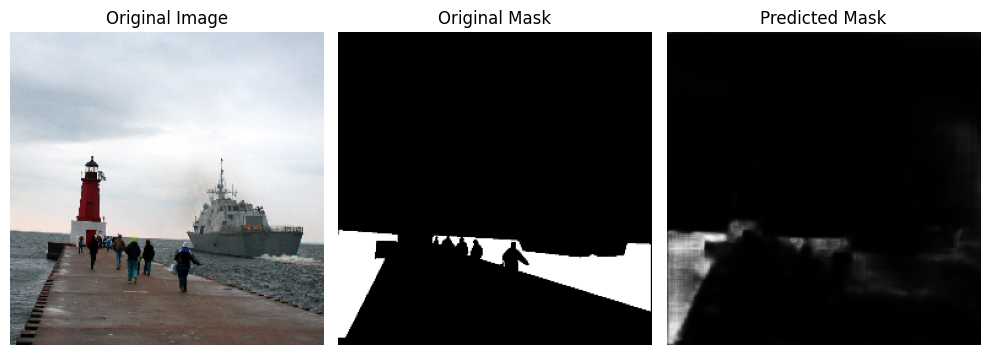

112/112 [==============================] - 48s 430ms/step - loss: 0.0795 - val_loss: 0.4757
Epoch 168/200
112/112 [==============================] - ETA: 0s - loss: 0.0570

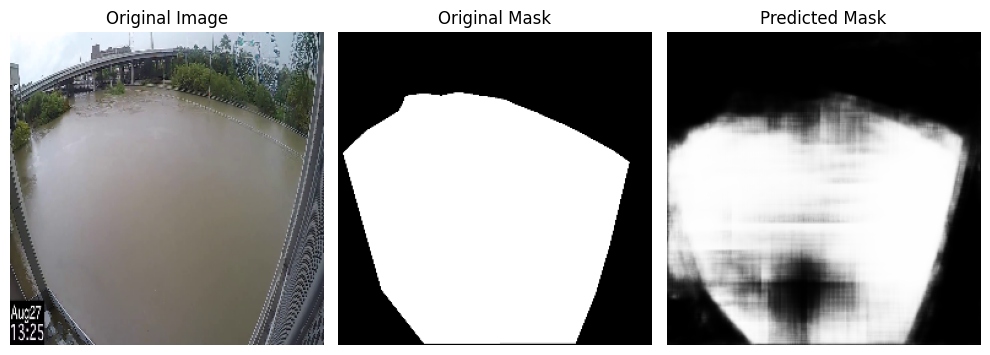

112/112 [==============================] - 48s 430ms/step - loss: 0.0570 - val_loss: 0.6544
Epoch 169/200
112/112 [==============================] - ETA: 0s - loss: 0.0473

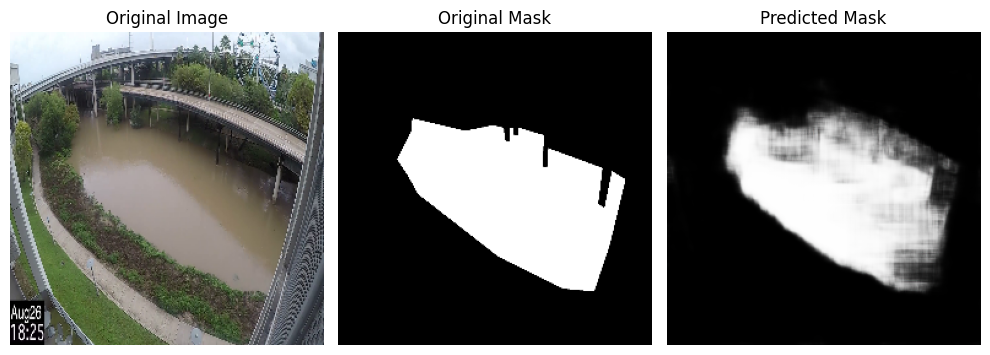

112/112 [==============================] - 48s 431ms/step - loss: 0.0473 - val_loss: 0.6242
Epoch 170/200
112/112 [==============================] - ETA: 0s - loss: 0.0467

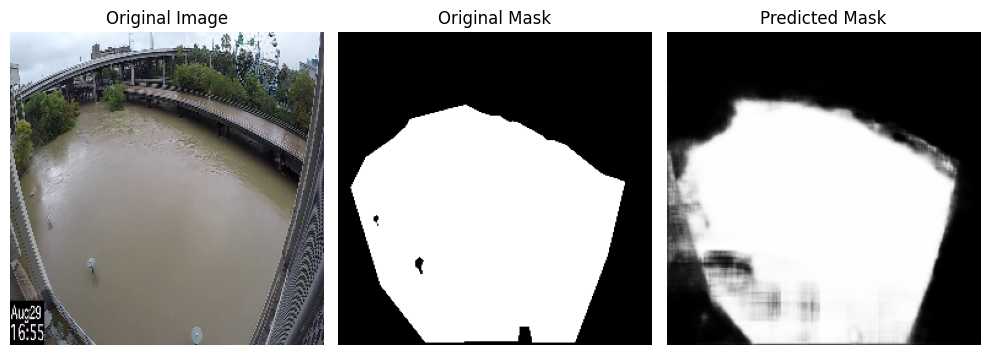

112/112 [==============================] - 49s 434ms/step - loss: 0.0467 - val_loss: 0.6569
Epoch 171/200
112/112 [==============================] - ETA: 0s - loss: 0.0410

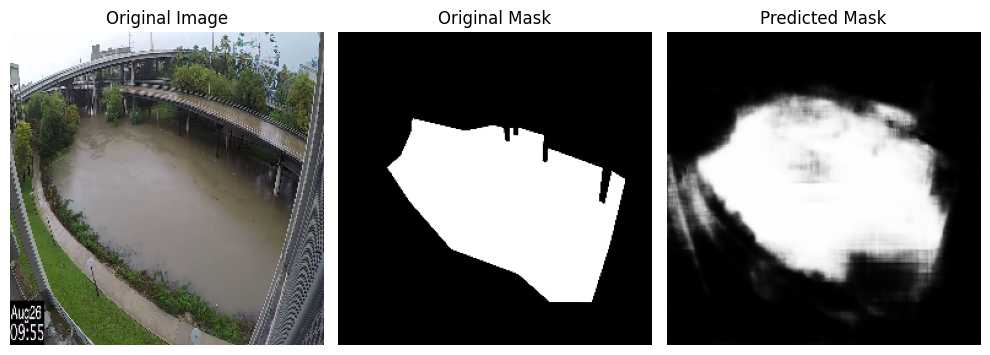

112/112 [==============================] - 48s 430ms/step - loss: 0.0410 - val_loss: 0.6692
Epoch 172/200
112/112 [==============================] - ETA: 0s - loss: 0.0399

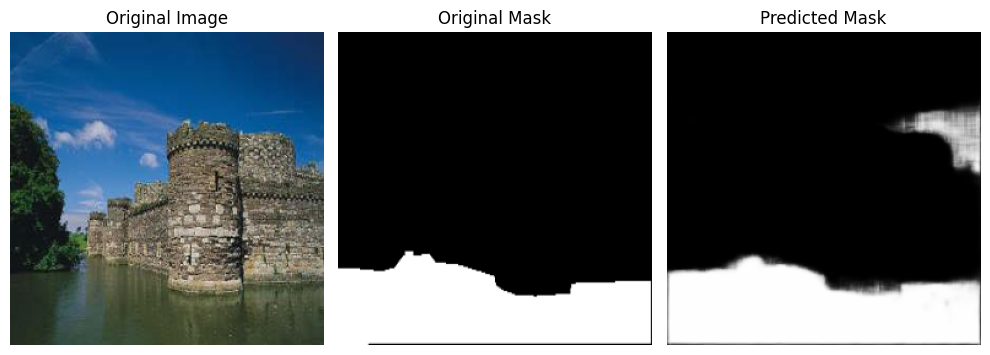

112/112 [==============================] - 48s 431ms/step - loss: 0.0399 - val_loss: 0.6561
Epoch 173/200
112/112 [==============================] - ETA: 0s - loss: 0.0382

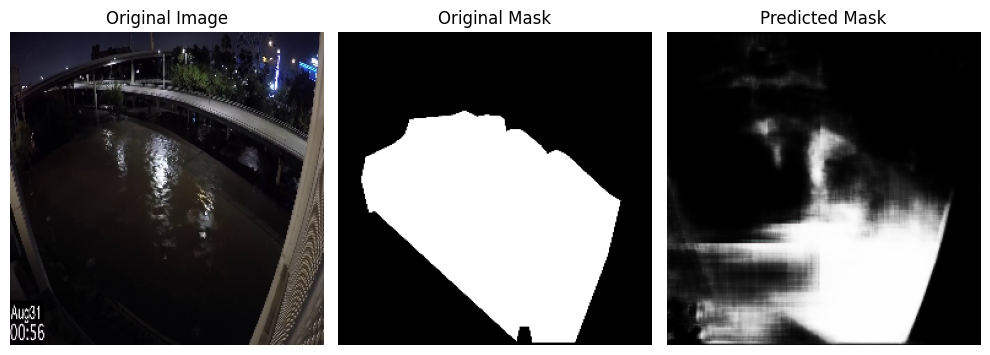

112/112 [==============================] - 48s 430ms/step - loss: 0.0382 - val_loss: 0.7216
Epoch 174/200
112/112 [==============================] - ETA: 0s - loss: 0.0364

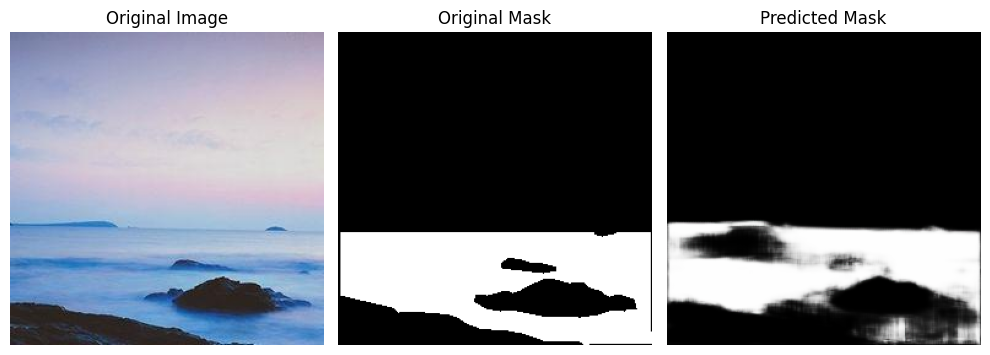

112/112 [==============================] - 48s 430ms/step - loss: 0.0364 - val_loss: 0.6698
Epoch 175/200
112/112 [==============================] - ETA: 0s - loss: 0.0367

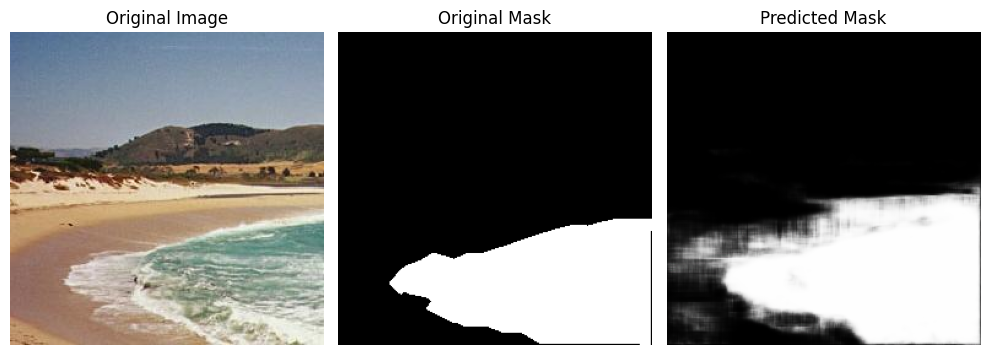

112/112 [==============================] - 48s 431ms/step - loss: 0.0367 - val_loss: 0.6753
Epoch 176/200
112/112 [==============================] - ETA: 0s - loss: 0.0426

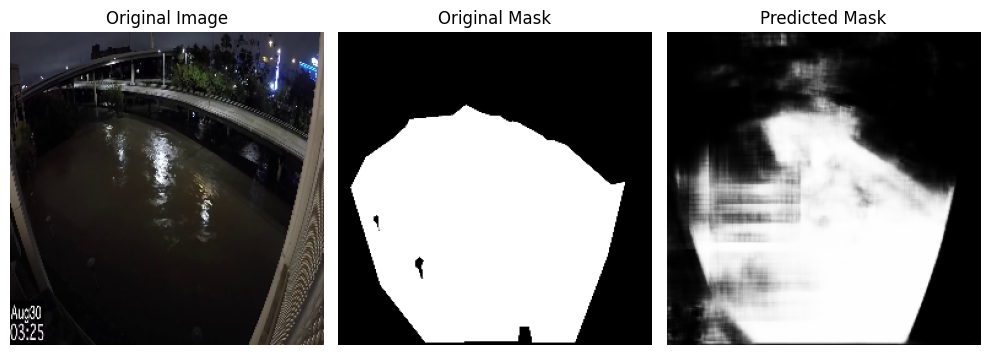

112/112 [==============================] - 48s 431ms/step - loss: 0.0426 - val_loss: 0.6547
Epoch 177/200
112/112 [==============================] - ETA: 0s - loss: 0.0374

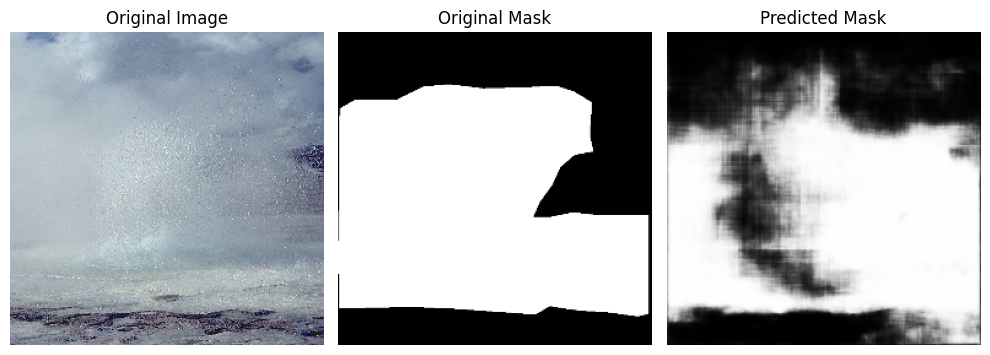

112/112 [==============================] - 48s 431ms/step - loss: 0.0374 - val_loss: 0.6523
Epoch 178/200
112/112 [==============================] - ETA: 0s - loss: 0.0372

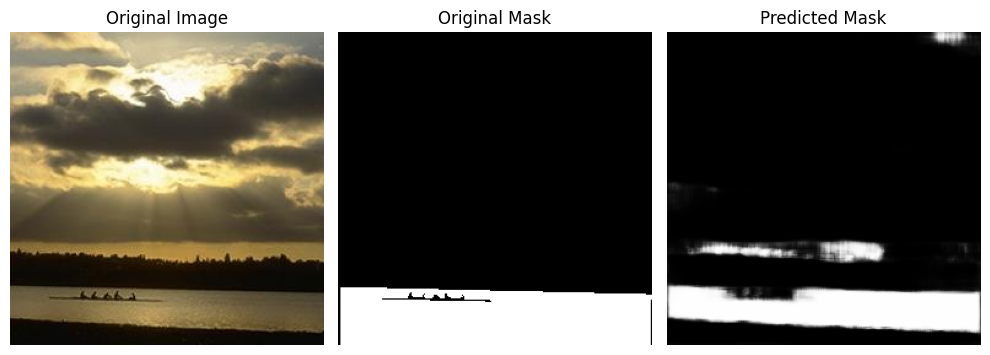

112/112 [==============================] - 48s 431ms/step - loss: 0.0372 - val_loss: 0.7401
Epoch 179/200
112/112 [==============================] - ETA: 0s - loss: 0.0352

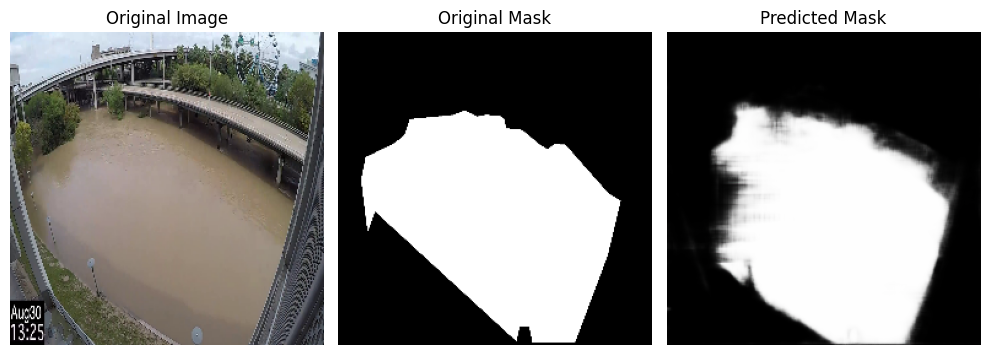

112/112 [==============================] - 48s 431ms/step - loss: 0.0352 - val_loss: 0.7159
Epoch 180/200
112/112 [==============================] - ETA: 0s - loss: 0.0386

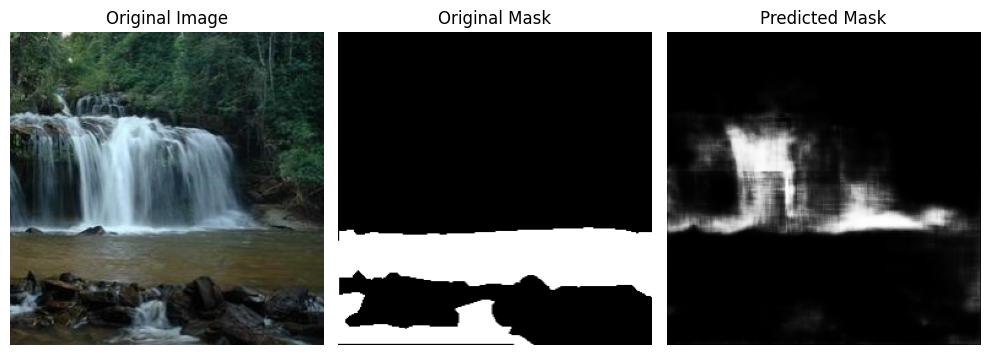

112/112 [==============================] - 48s 431ms/step - loss: 0.0386 - val_loss: 0.5983
Epoch 181/200
112/112 [==============================] - ETA: 0s - loss: 0.0481

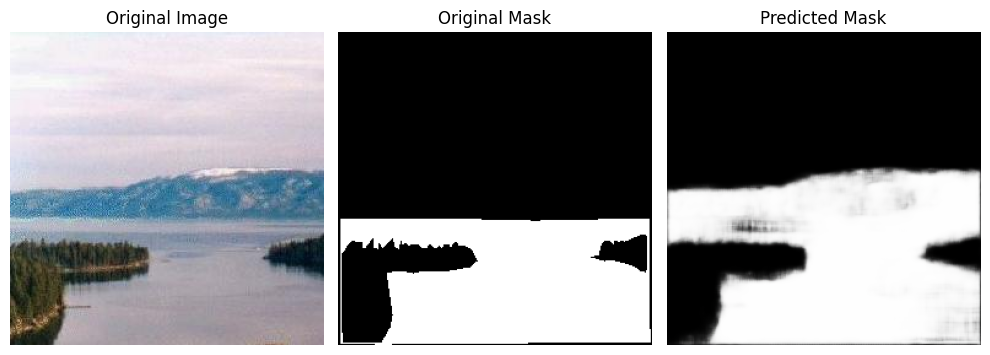

112/112 [==============================] - 48s 430ms/step - loss: 0.0481 - val_loss: 0.6934
Epoch 182/200
112/112 [==============================] - ETA: 0s - loss: 0.0475

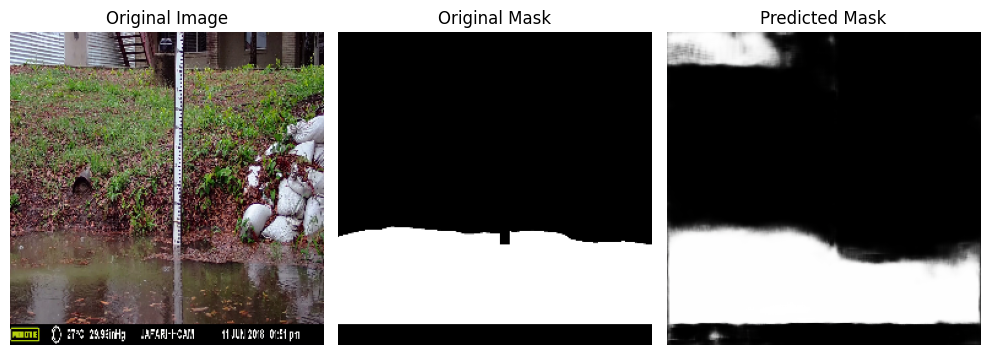

112/112 [==============================] - 48s 430ms/step - loss: 0.0475 - val_loss: 0.8402
Epoch 183/200
112/112 [==============================] - ETA: 0s - loss: 0.0788

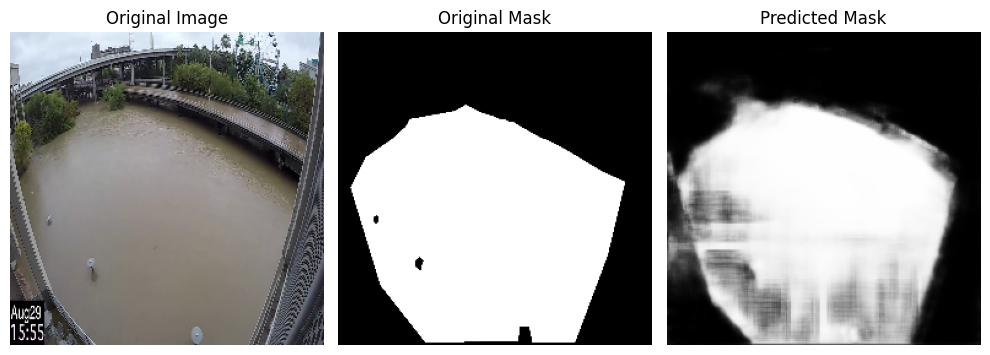

112/112 [==============================] - 48s 430ms/step - loss: 0.0788 - val_loss: 0.5439
Epoch 184/200
112/112 [==============================] - ETA: 0s - loss: 0.0659

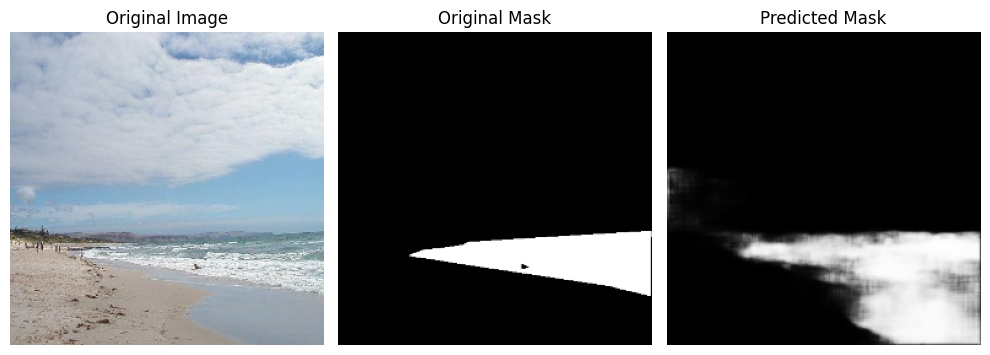

112/112 [==============================] - 48s 430ms/step - loss: 0.0659 - val_loss: 0.7369
Epoch 185/200
112/112 [==============================] - ETA: 0s - loss: 0.0491

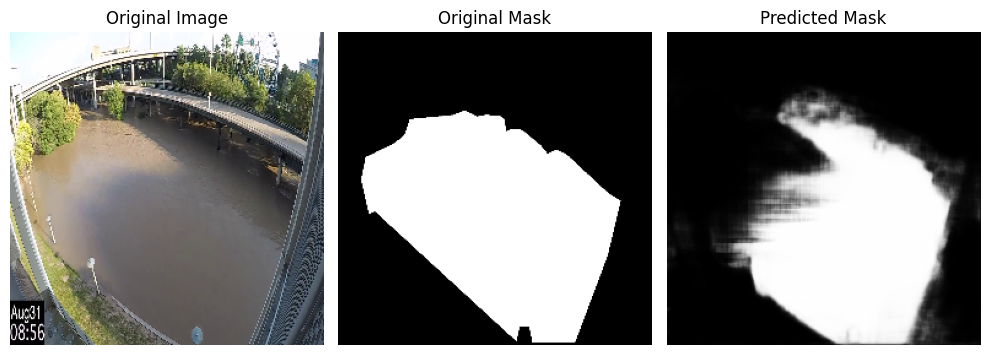

112/112 [==============================] - 48s 433ms/step - loss: 0.0491 - val_loss: 0.6556
Epoch 186/200
112/112 [==============================] - ETA: 0s - loss: 0.0421

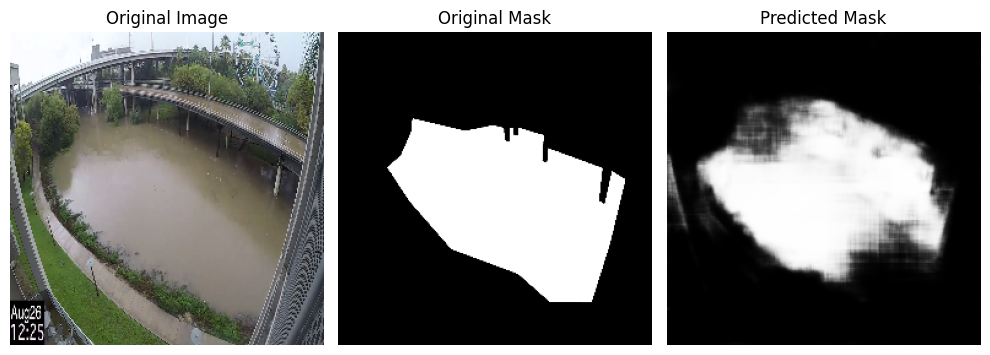

112/112 [==============================] - 48s 430ms/step - loss: 0.0421 - val_loss: 0.6608
Epoch 187/200
112/112 [==============================] - ETA: 0s - loss: 0.0370

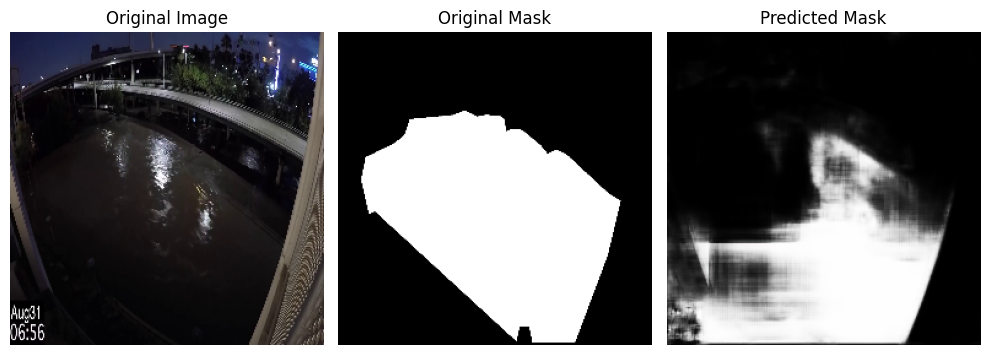

112/112 [==============================] - 48s 430ms/step - loss: 0.0370 - val_loss: 0.6360
Epoch 188/200
112/112 [==============================] - ETA: 0s - loss: 0.0380

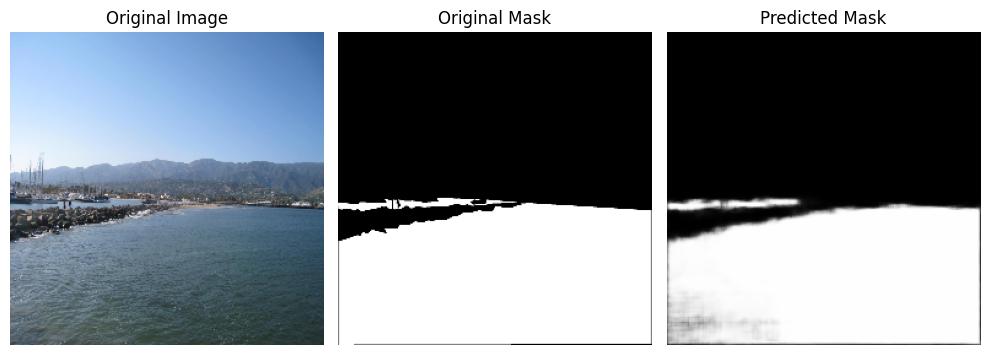

112/112 [==============================] - 48s 431ms/step - loss: 0.0380 - val_loss: 0.6319
Epoch 189/200
112/112 [==============================] - ETA: 0s - loss: 0.0361

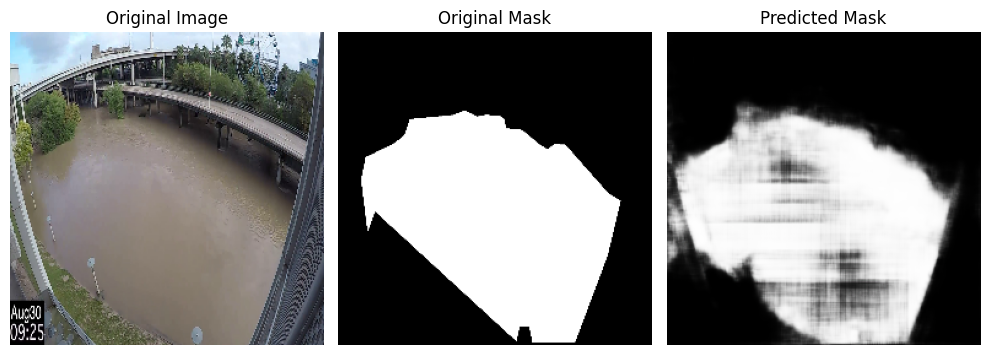

112/112 [==============================] - 48s 430ms/step - loss: 0.0361 - val_loss: 0.7337
Epoch 190/200
112/112 [==============================] - ETA: 0s - loss: 0.0505

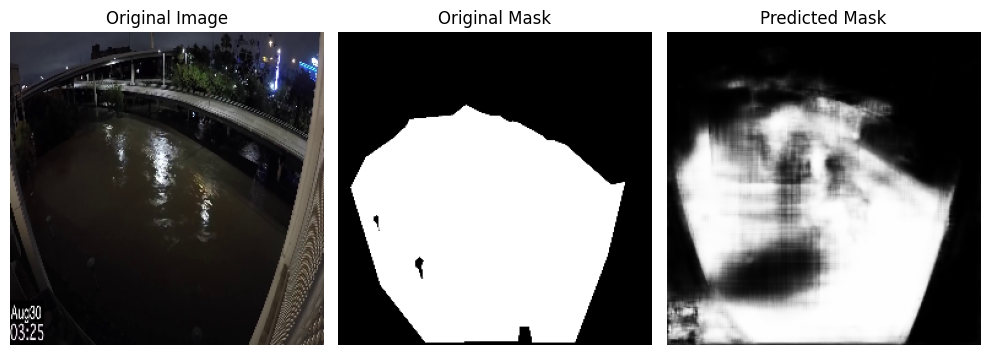

112/112 [==============================] - 48s 430ms/step - loss: 0.0505 - val_loss: 0.6113
Epoch 191/200
112/112 [==============================] - ETA: 0s - loss: 0.0417

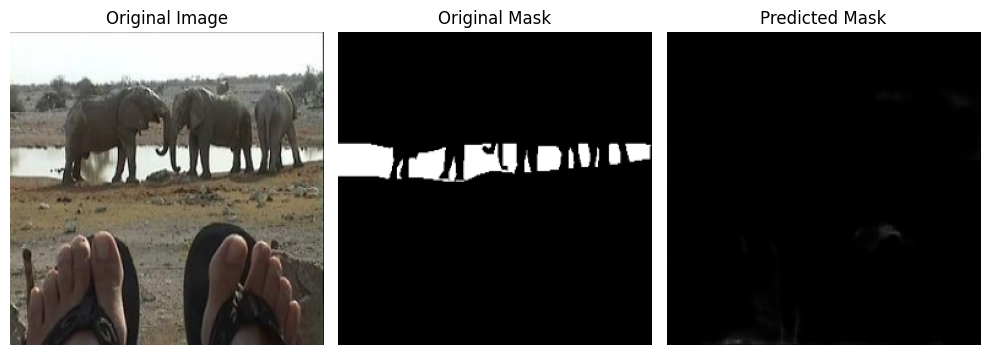

112/112 [==============================] - 48s 430ms/step - loss: 0.0417 - val_loss: 0.5914
Epoch 192/200
112/112 [==============================] - ETA: 0s - loss: 0.0361

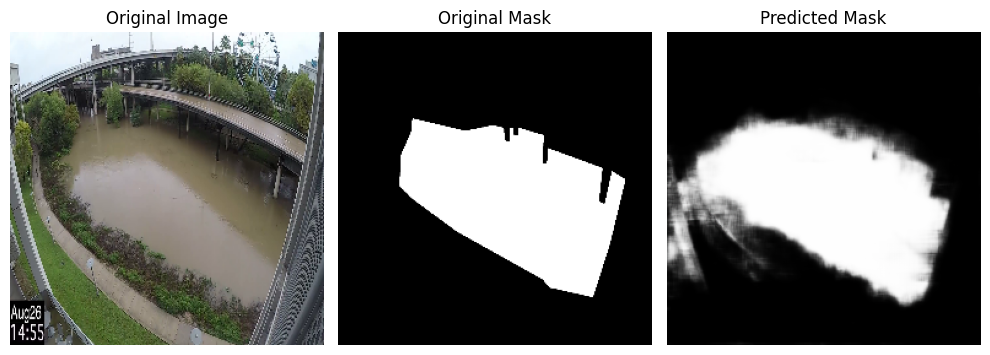

112/112 [==============================] - 48s 430ms/step - loss: 0.0361 - val_loss: 0.6745
Epoch 193/200
112/112 [==============================] - ETA: 0s - loss: 0.0343

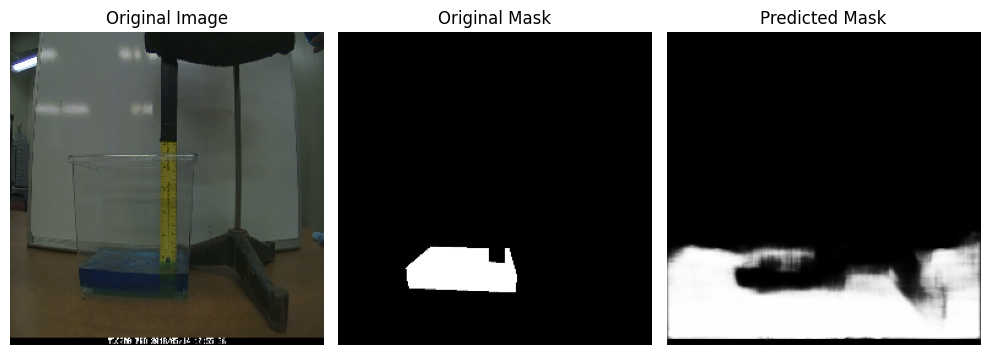

112/112 [==============================] - 48s 430ms/step - loss: 0.0343 - val_loss: 0.6639
Epoch 194/200
112/112 [==============================] - ETA: 0s - loss: 0.0390

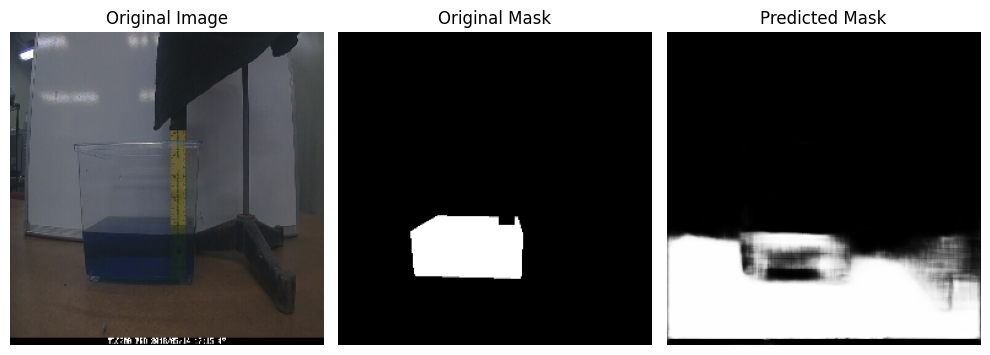

112/112 [==============================] - 48s 431ms/step - loss: 0.0390 - val_loss: 0.6908
Epoch 195/200
112/112 [==============================] - ETA: 0s - loss: 0.0352

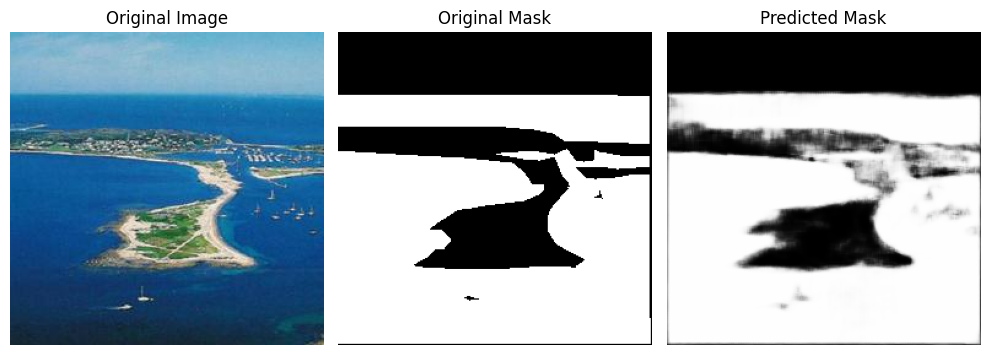

112/112 [==============================] - 48s 431ms/step - loss: 0.0352 - val_loss: 0.7008
Epoch 196/200
112/112 [==============================] - ETA: 0s - loss: 0.0337

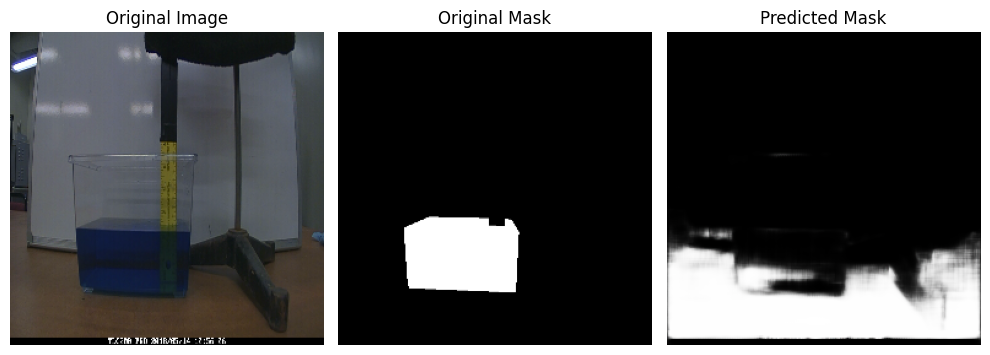

112/112 [==============================] - 48s 431ms/step - loss: 0.0337 - val_loss: 0.6732
Epoch 197/200
112/112 [==============================] - ETA: 0s - loss: 0.0366

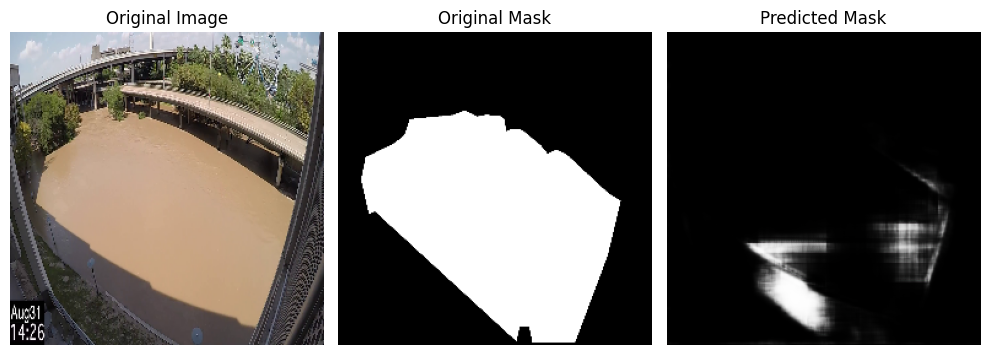

112/112 [==============================] - 48s 430ms/step - loss: 0.0366 - val_loss: 0.6871
Epoch 198/200
112/112 [==============================] - ETA: 0s - loss: 0.0347

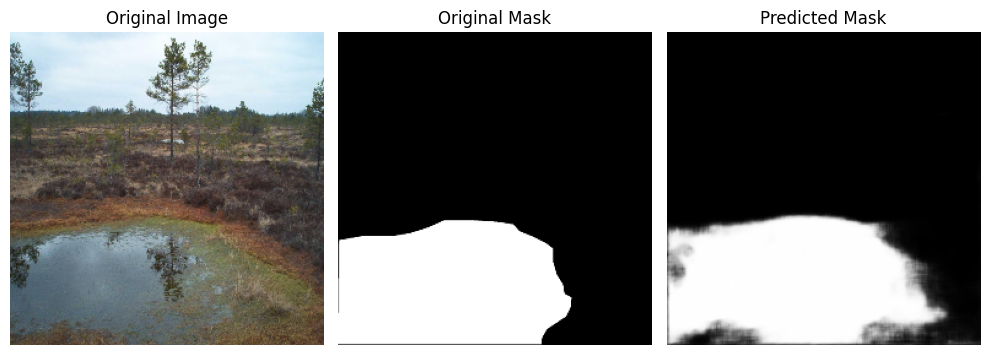

112/112 [==============================] - 48s 430ms/step - loss: 0.0347 - val_loss: 0.7698
Epoch 199/200
112/112 [==============================] - ETA: 0s - loss: 0.0375

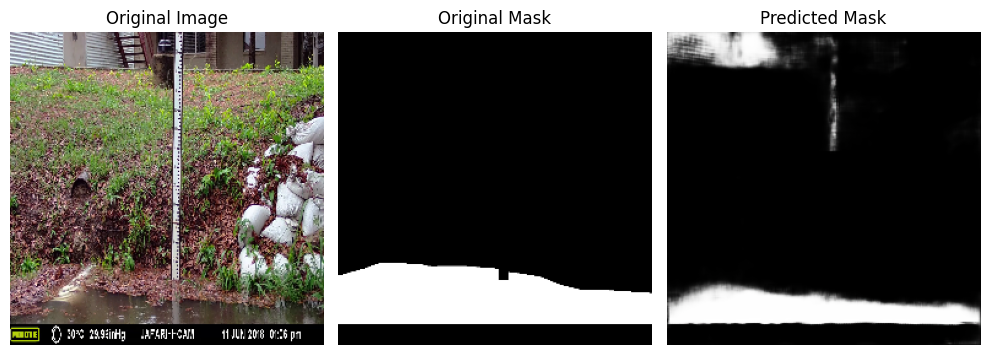

112/112 [==============================] - 48s 430ms/step - loss: 0.0375 - val_loss: 0.7140
Epoch 200/200
112/112 [==============================] - ETA: 0s - loss: 0.0583

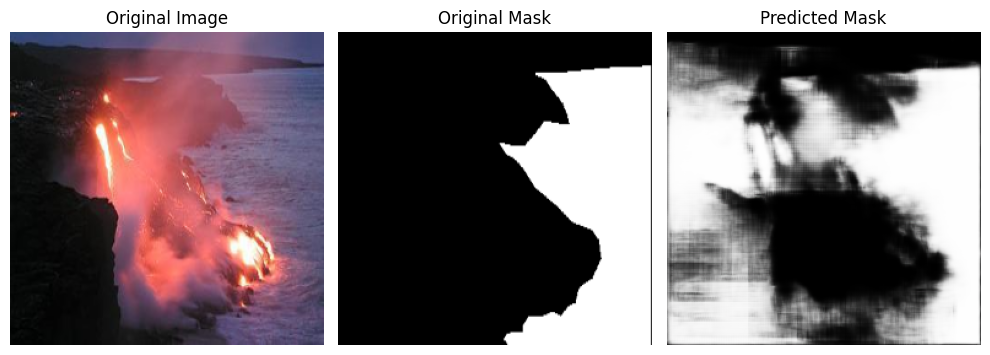

112/112 [==============================] - 48s 433ms/step - loss: 0.0583 - val_loss: 0.5720


In [23]:
UNet.fit(
    X_train, y_train,
    epochs=200,
    batch_size=BATCH_SIZE,
    steps_per_epoch=SPE,
    validation_data=(X_val, y_val),
    callbacks=cbs
)

----------------